In [1]:
import os
import scanpy as sc
import skmisc
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import gzip
from matplotlib.pyplot import rc_context
import anndata as ad  # Importa anndata
import numpy as np

sc.set_figure_params(dpi=100)

In [2]:
import scvi

In [3]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

In [ ]:
#ESTO SON LOS DATOS DEL CELLRANGER 7.1

# # Diccionario con las rutas para los datos filtrados y raw
# sample_paths = {
#     "Mouse_44-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_44-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_44-final/outs/per_sample_outs/Mouse_44-final/count/sample_filtered_feature_bc_matrix.h5'
#     },
#     "Mouse_45-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_45-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_45-final/outs/per_sample_outs/Mouse_45-final/count/sample_filtered_feature_bc_matrix.h5'
#     },
#     "Mouse_48-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_48-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_48-final/outs/per_sample_outs/Mouse_48-final/count/sample_filtered_feature_bc_matrix.h5'
#     },
#     "Mouse_49-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_49-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_49-final/outs/per_sample_outs/Mouse_49-final/count/sample_filtered_feature_bc_matrix.h5'
#     },
#     "Mouse_50-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_50-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_50-final/outs/per_sample_outs/Mouse_50-final/count/sample_filtered_feature_bc_matrix.h5'
#     },
#     "Mouse_52-final": {
#         "raw": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_52-final/outs/multi/count/raw_feature_bc_matrix.h5',
#         "filtered": '/data/scratch/LAB/enric/TFM_enric/00_final_analysis_cellmulti/Mouse_52-final/outs/per_sample_outs/Mouse_52-final/count/sample_filtered_feature_bc_matrix.h5'
#     }
# }

# # Comparar el número de células en cada archivo raw y filtrado
# for sample_name, paths in sample_paths.items():
#     # Cargar los datos raw
#     adata_raw = sc.read_10x_h5(paths["raw"])
    
#     # Cargar los datos filtrados
#     adata_filtered = sc.read_10x_h5(paths["filtered"])
    
#     # Obtener el número de células (barcodes) en cada dataset
#     n_cells_raw = adata_raw.n_obs
#     n_cells_filtered = adata_filtered.n_obs
    
#     # Mostrar los resultados
#     print(f"{sample_name}:")
#     print(f"  Número de células en datos raw: {n_cells_raw}")
#     print(f"  Número de células en datos filtrados: {n_cells_filtered}")
#     print("-" * 40)


In [3]:
# Diccionario con las rutas para los datos filtrados y raw actualizadas
sample_paths = {
    "Mouse_44-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_44-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_44-final/outs/per_sample_outs/Mouse_44-final/count/sample_filtered_feature_bc_matrix.h5'
    },
    "Mouse_45-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_45-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_45-final/outs/per_sample_outs/Mouse_45-final/count/sample_filtered_feature_bc_matrix.h5'
    },
    "Mouse_48-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_48-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_48-final/outs/per_sample_outs/Mouse_48-final/count/sample_filtered_feature_bc_matrix.h5'
    },
    "Mouse_49-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_49-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_49-final/outs/per_sample_outs/Mouse_49-final/count/sample_filtered_feature_bc_matrix.h5'
    },
    "Mouse_50-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_50-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_50-final/outs/per_sample_outs/Mouse_50-final/count/sample_filtered_feature_bc_matrix.h5'
    },
    "Mouse_52-final": {
        "raw": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_52-final/outs/multi/count/raw_feature_bc_matrix.h5',
        "filtered": '/data/scratch/LAB/enric/TFM_enric/000_Cellranger_8/Mouse_52-final/outs/per_sample_outs/Mouse_52-final/count/sample_filtered_feature_bc_matrix.h5'
    }
}

# Comparar el número de células en cada archivo raw y filtrado
for sample_name, paths in sample_paths.items():
    # Cargar los datos raw
    adata_raw = sc.read_10x_h5(paths["raw"])
    
    # Cargar los datos filtrados
    adata_filtered = sc.read_10x_h5(paths["filtered"])
    
    # Obtener el número de células (barcodes) en cada dataset
    n_cells_raw = adata_raw.n_obs
    n_cells_filtered = adata_filtered.n_obs
    
    # Mostrar los resultados
    print(f"{sample_name}:")
    print(f"  Número de células en datos raw: {n_cells_raw}")
    print(f"  Número de células en datos filtrados: {n_cells_filtered}")
    print("-" * 40)


Mouse_44-final:
  Número de células en datos raw: 3274
  Número de células en datos filtrados: 1432
----------------------------------------
Mouse_45-final:
  Número de células en datos raw: 3450
  Número de células en datos filtrados: 2295
----------------------------------------
Mouse_48-final:
  Número de células en datos raw: 897
  Número de células en datos filtrados: 431
----------------------------------------
Mouse_49-final:
  Número de células en datos raw: 1449
  Número de células en datos filtrados: 703
----------------------------------------
Mouse_50-final:
  Número de células en datos raw: 3264
  Número de células en datos filtrados: 2318
----------------------------------------
Mouse_52-final:
  Número de células en datos raw: 2480
  Número de células en datos filtrados: 1608
----------------------------------------


In [4]:
# Cargar los datos filtrados en variables separadas
mouse_44 = sc.read_10x_h5(sample_paths["Mouse_44-final"]["filtered"])
mouse_45 = sc.read_10x_h5(sample_paths["Mouse_45-final"]["filtered"])
mouse_48 = sc.read_10x_h5(sample_paths["Mouse_48-final"]["filtered"])
mouse_49 = sc.read_10x_h5(sample_paths["Mouse_49-final"]["filtered"])
mouse_50 = sc.read_10x_h5(sample_paths["Mouse_50-final"]["filtered"])
mouse_52 = sc.read_10x_h5(sample_paths["Mouse_52-final"]["filtered"])

In [5]:
# Primero para los datos raw
for sample_name, paths in sample_paths.items():
    adata_raw = sc.read_10x_h5(paths["raw"])
    
    # Verificar duplicados antes
    duplicates_before = adata_raw.var_names.duplicated().sum()
    
    # Hacer únicos los nombres de genes
    adata_raw.var_names_make_unique()
    
    # Verificar duplicados después
    duplicates_after = adata_raw.var_names.duplicated().sum()
    
    # Mostrar resultados para raw
    print(f"{sample_name} (raw):")
    print(f"  Duplicados antes: {duplicates_before}")
    print(f"  Duplicados después: {duplicates_after}")

# Ahora para los datos filtrados
for sample_name, adata in zip(
    ["Mouse_44", "Mouse_45", "Mouse_48", "Mouse_49", "Mouse_50", "Mouse_52"],
    [mouse_44, mouse_45, mouse_48, mouse_49, mouse_50, mouse_52]
):
    # Verificar duplicados antes
    duplicates_before = adata.var_names.duplicated().sum()
    
    # Hacer únicos los nombres de genes
    adata.var_names_make_unique()
    
    # Verificar duplicados después
    duplicates_after = adata.var_names.duplicated().sum()
    
    # Mostrar resultados para filtrados
    print(f"{sample_name} (filtered):")
    print(f"  Duplicados antes: {duplicates_before}")
    print(f"  Duplicados después: {duplicates_after}")


Mouse_44-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_45-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_48-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_49-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_50-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_52-final (raw):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_44 (filtered):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_45 (filtered):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_48 (filtered):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_49 (filtered):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_50 (filtered):
  Duplicados antes: 40
  Duplicados después: 0
Mouse_52 (filtered):
  Duplicados antes: 40
  Duplicados después: 0


In [6]:
import os

# Rutas para guardar los archivos h5ad
output_dir_filtered = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/"
output_dir_raw = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/"

# Crear los directorios si no existen
os.makedirs(output_dir_filtered, exist_ok=True)
os.makedirs(output_dir_raw, exist_ok=True)

# Guardar los datos raw
for sample_name, paths in sample_paths.items():
    adata_raw = sc.read_10x_h5(paths["raw"])
    adata_raw.var_names_make_unique()  # Asegurar que los nombres de genes sean únicos
    adata_raw.write_h5ad(f"{output_dir_raw}/{sample_name}_raw.h5ad")

# Guardar los datos filtrados
for sample_name, adata in zip(
    ["Mouse_44", "Mouse_45", "Mouse_48", "Mouse_49", "Mouse_50", "Mouse_52"],
    [mouse_44, mouse_45, mouse_48, mouse_49, mouse_50, mouse_52]
):
    adata.var_names_make_unique()  # Asegurar que los nombres de genes sean únicos
    adata.write_h5ad(f"{output_dir_filtered}/{sample_name}_filtered.h5ad")

In [11]:
import scanpy as sc

# Cargar las matrices filtradas
mouse_44_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_44_filtered.h5ad")
mouse_45_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_45_filtered.h5ad")
mouse_48_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_48_filtered.h5ad")
mouse_49_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_49_filtered.h5ad")
mouse_50_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_50_filtered.h5ad")
mouse_52_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices/Mouse_52_filtered.h5ad")

# Cargar las matrices raw 
mouse_44_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_44-final_raw.h5ad")
mouse_45_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_45-final_raw.h5ad")
mouse_48_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_48-final_raw.h5ad")
mouse_49_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_49-final_raw.h5ad")
mouse_50_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_50-final_raw.h5ad")
mouse_52_raw = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/raw_matrices/Mouse_52-final_raw.h5ad")

In [8]:
#creamos la lista con los 6 Anndata
adata_list = [
    mouse_44_filtered,
    mouse_45_filtered,
    mouse_48_filtered,
    mouse_49_filtered,
    mouse_50_filtered,
    mouse_52_filtered
]

In [9]:
# Limpiamos el mRNA ambiental también con Cellbender
!sbatch /data/scratch/LAB/enric/TFM_enric/scripts_auxiliares_jupyter/run_cellbender.sh

Submitted batch job 716934


AQUI CARGAMOS LAS CÉLULAS LIMPIAS DE mRNA ambiental del SoupX

In [4]:
import scanpy as sc

# Definir la función de preprocesamiento
def preprocess_data(adata):
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)
    sc.pp.highly_variable_genes(adata, n_top_genes=3000, subset=True, flavor='seurat_v3')
    return adata

# Lista de ratones y archivos AnnData correspondientes corregidos por SoupX
mouse_files = {
    "Mouse_44": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_44_corrected_SoupX.h5ad",
    "Mouse_45": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_45_corrected_SoupX.h5ad",
    "Mouse_48": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_48_corrected_SoupX.h5ad",
    "Mouse_49": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_49_corrected_SoupX.h5ad",
    "Mouse_50": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_50_corrected_SoupX.h5ad",
    "Mouse_52": "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_52_corrected_SoupX.h5ad"
}

# Directorio de salida
output_dir = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/predicciones_dobletes/process_for_doublets/"

# Aplicar preprocesamiento a cada ratón y guardar los resultados
for mouse_name, file_path in mouse_files.items():
    # Cargar los datos corregidos por SoupX del ratón
    adata = sc.read_h5ad(file_path)
    
    # Aplicar preprocesamiento
    adata = preprocess_data(adata)
    
    # Guardar los datos preprocesados
    adata.write_h5ad(f"{output_dir}{mouse_name}_preprocessed_SoupX.h5ad")

In [6]:
# Calcular el número total de células filtradas
total_cells = 0

for mouse_name, file_path in mouse_files.items():
    # Cargar los datos
    adata = sc.read_h5ad(file_path)
    
    # Aplicar preprocesamiento
    adata = preprocess_data(adata)
    
    # Sumar las células filtradas de cada muestra
    total_cells += adata.n_obs
print(f"Total de células filtradas: {total_cells}")

Total de células filtradas: 7553


In [15]:
# LANZAMOS LA DETECCION DE DOBLETES PARA CADA RATON
!sbatch /data/scratch/LAB/enric/TFM_enric/scripts_auxiliares_jupyter/scvi_dobletes_SOLO.sh 

Submitted batch job 717001


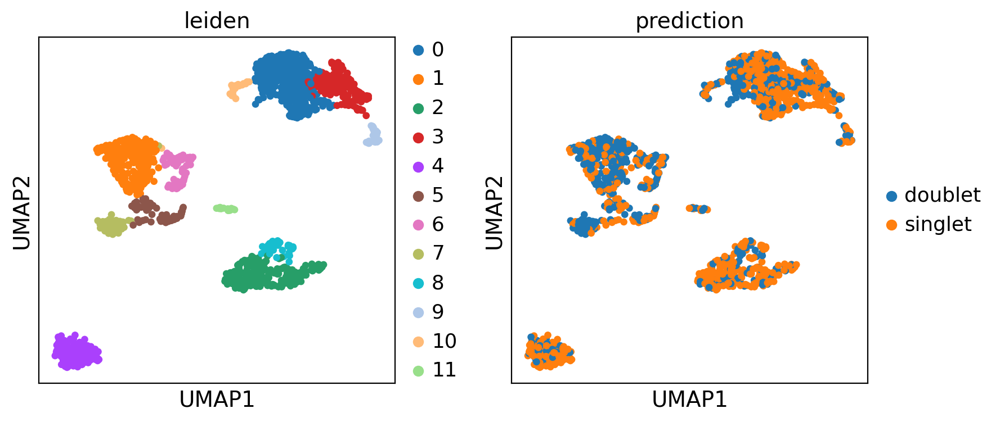

Ratón: Mouse_44
Total de células: 1432
Número de singletes: 845 (59.01%)
Número de dobletes: 587 (40.99%)

Mouse_44: Total células filtradas: 845


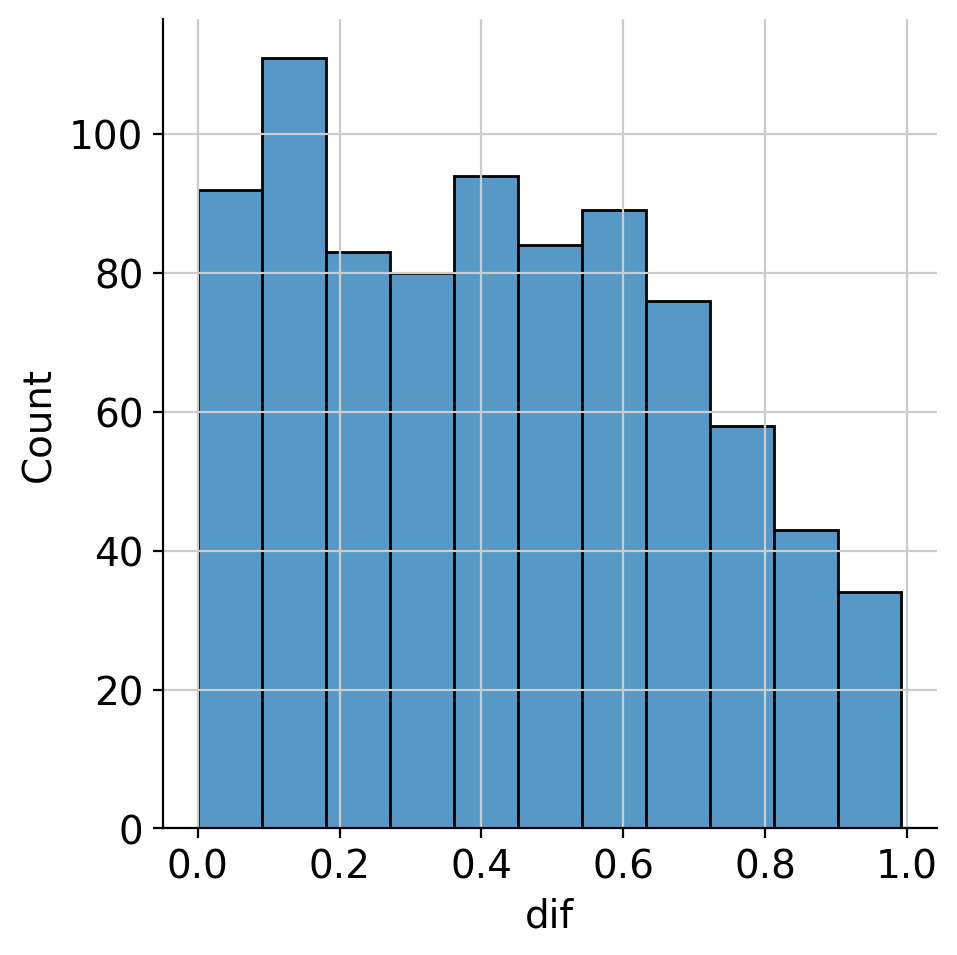

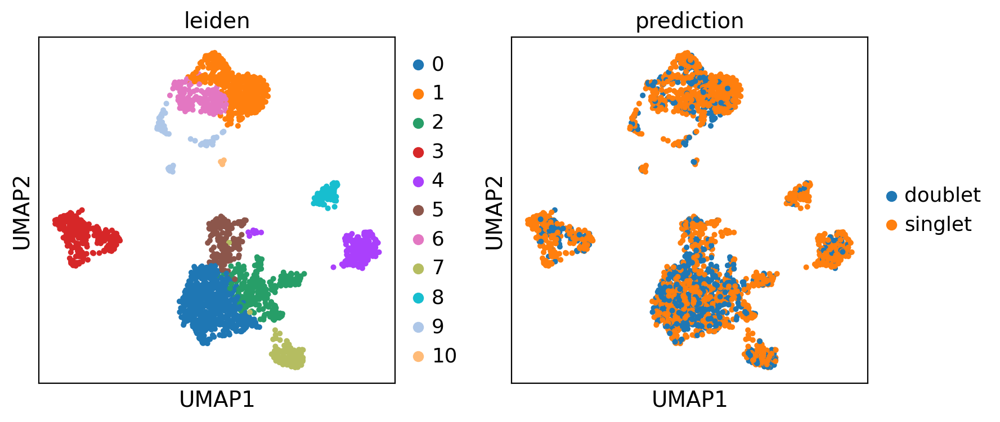

Ratón: Mouse_45
Total de células: 2295
Número de singletes: 1526 (66.49%)
Número de dobletes: 769 (33.51%)

Mouse_45: Total células filtradas: 1526


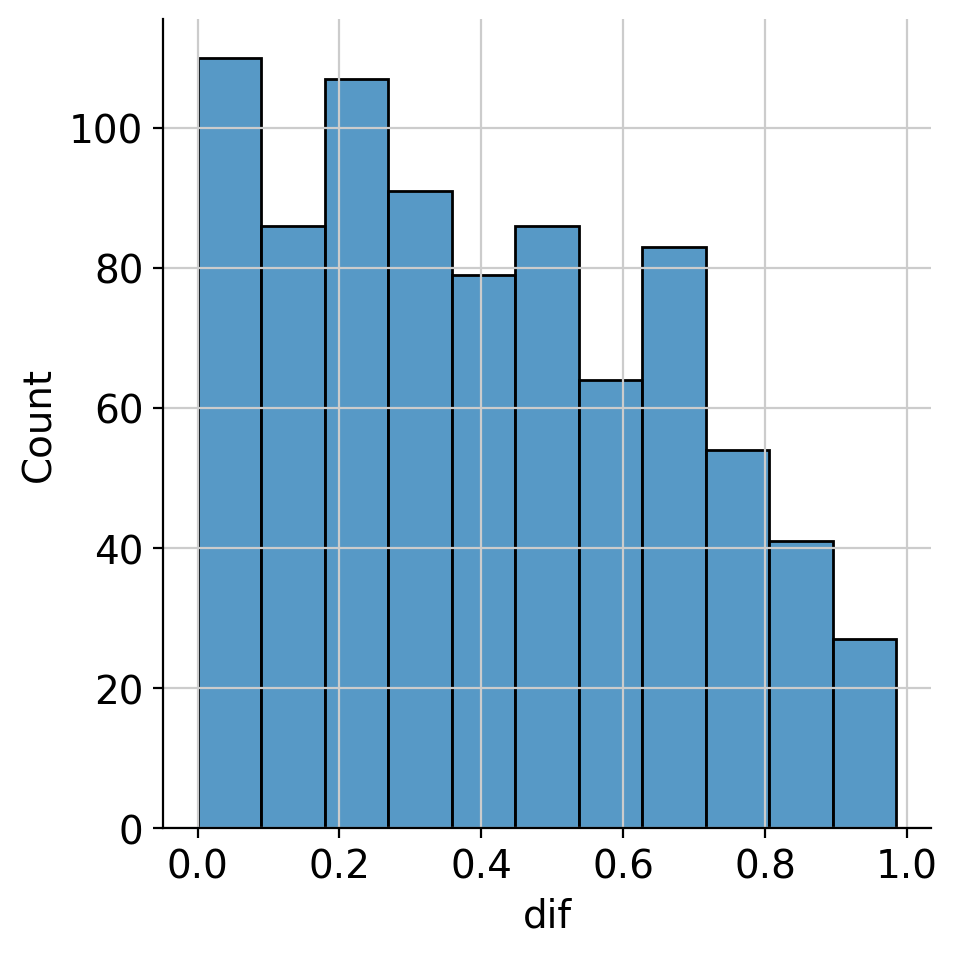

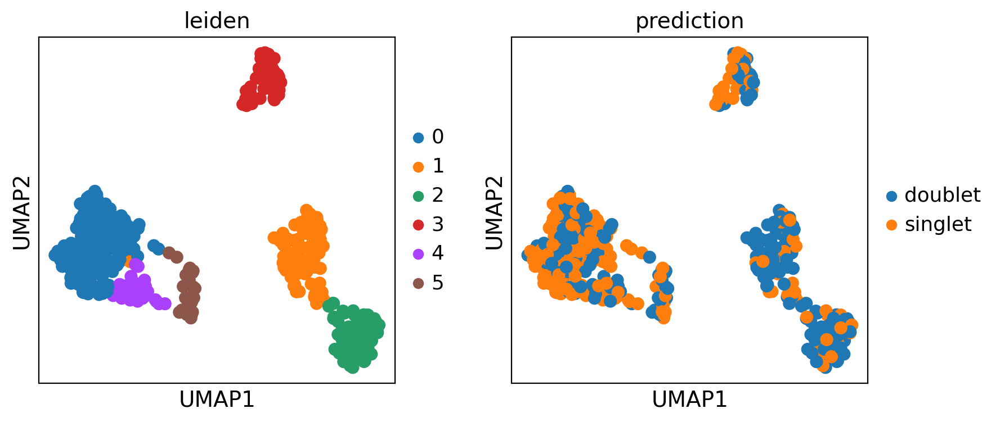

Ratón: Mouse_48
Total de células: 431
Número de singletes: 201 (46.64%)
Número de dobletes: 230 (53.36%)

Mouse_48: Total células filtradas: 201


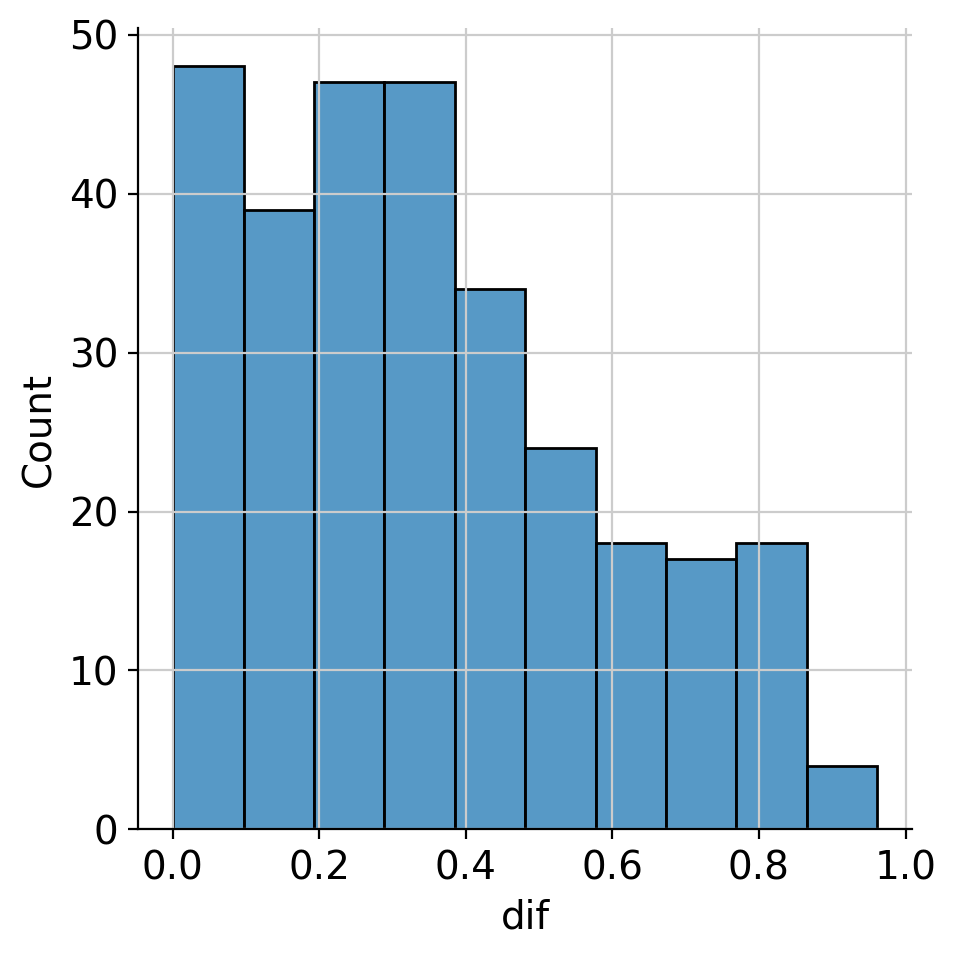

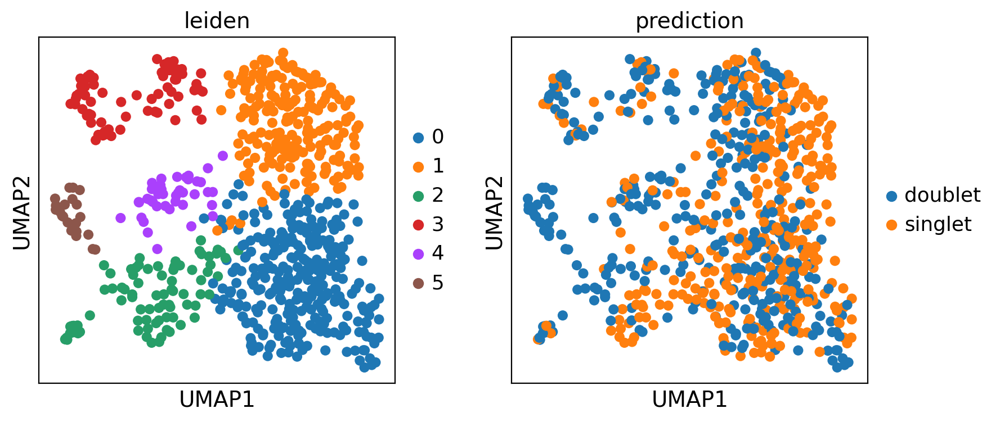

Ratón: Mouse_49
Total de células: 703
Número de singletes: 354 (50.36%)
Número de dobletes: 349 (49.64%)

Mouse_49: Total células filtradas: 354


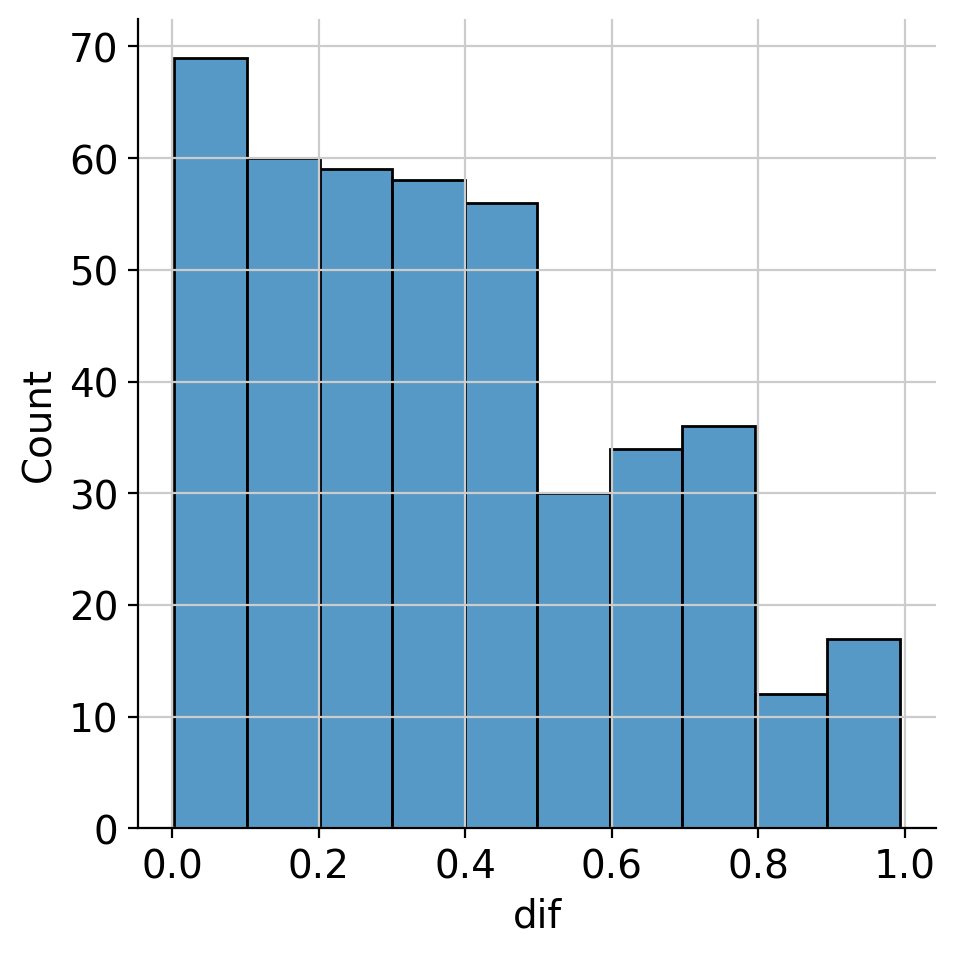

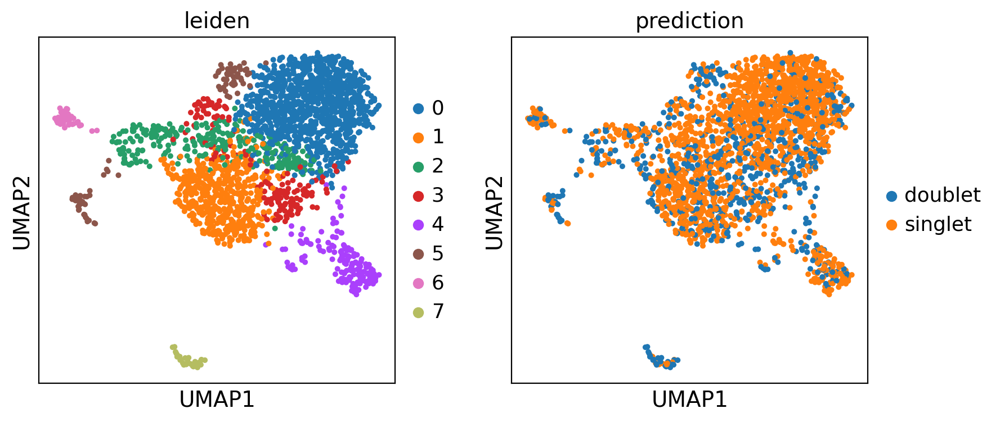

Ratón: Mouse_50
Total de células: 2318
Número de singletes: 1668 (71.96%)
Número de dobletes: 650 (28.04%)

Mouse_50: Total células filtradas: 1668


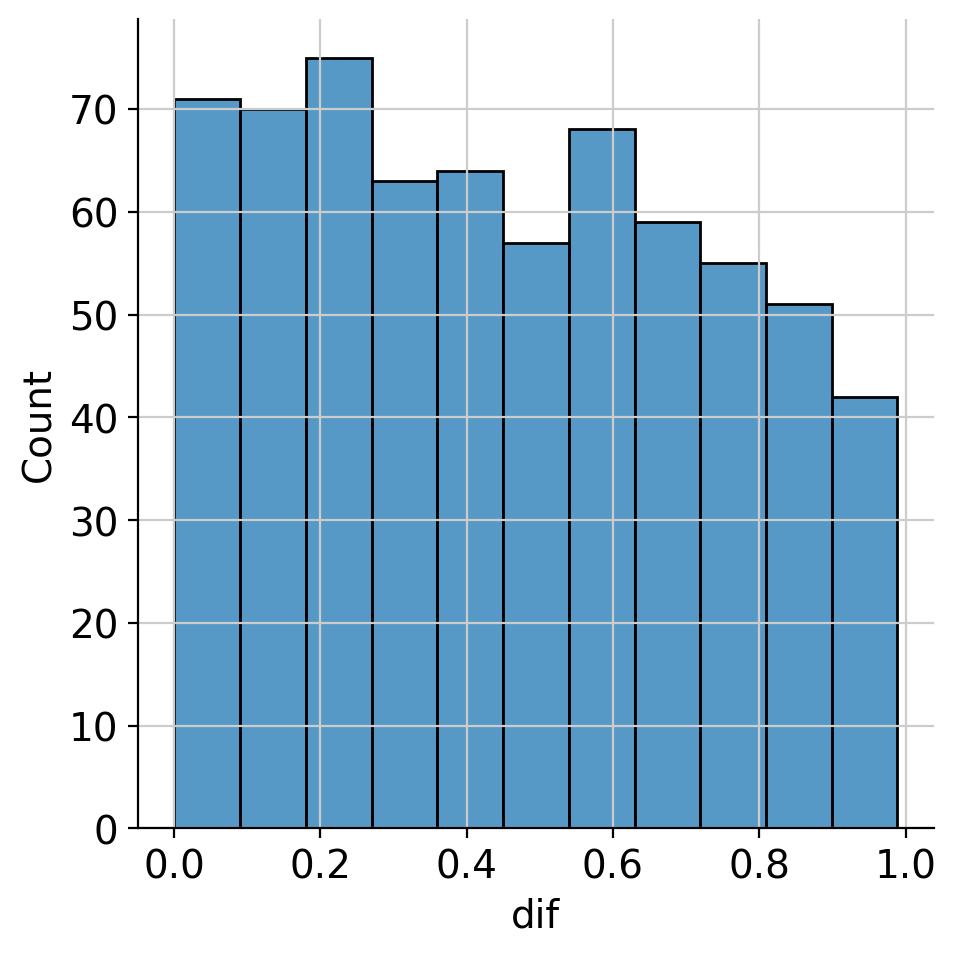

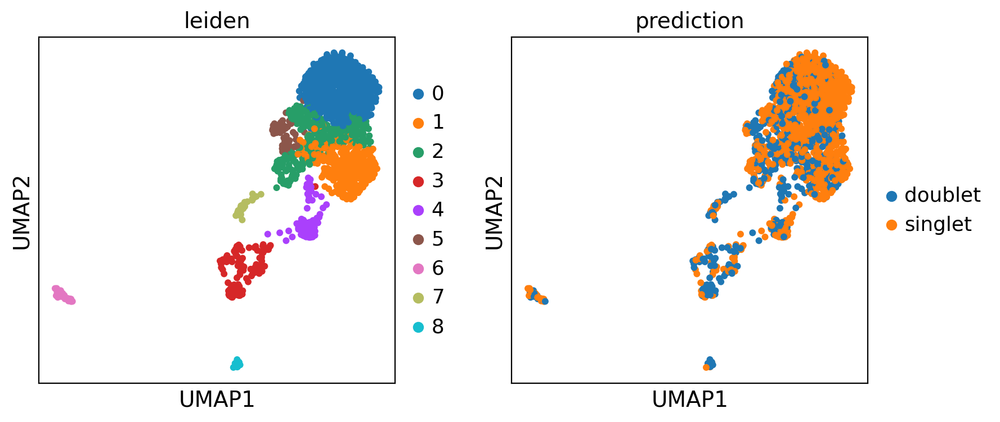

Ratón: Mouse_52
Total de células: 1608
Número de singletes: 1100 (68.41%)
Número de dobletes: 508 (31.59%)

Mouse_52: Total células filtradas: 1100


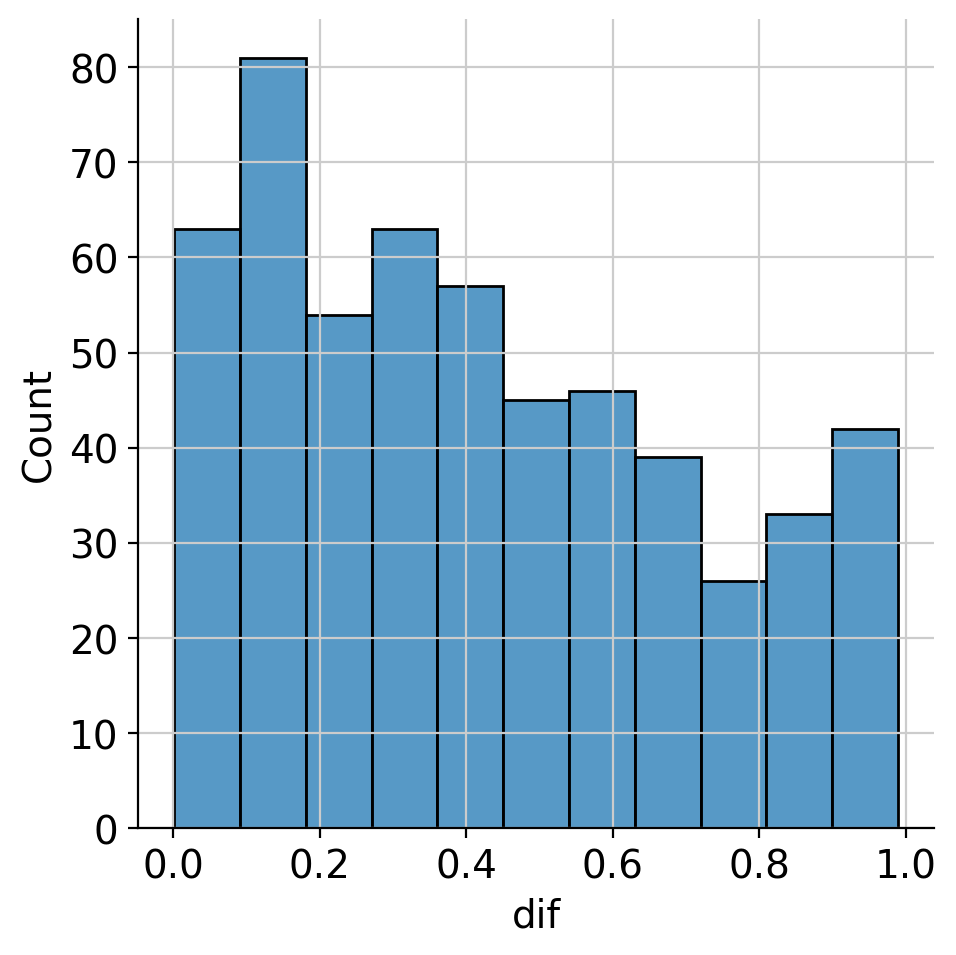

In [12]:
# CON LAS MATRICES FILTRADAS SIN REMOVER EL RNA AMBIENTAL VEMOS LA DETECCION DE DOBLETES
import scanpy as sc
import pandas as pd
import seaborn as sns
from matplotlib.pyplot import rc_context

# Ruta base para las predicciones
prediction_base_path = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/predicciones_dobletes/"

# Lista de ratones y sus respectivos archivos AnnData
mouse_data = {
    "Mouse_44": mouse_44_filtered,
    "Mouse_45": mouse_45_filtered,
    "Mouse_48": mouse_48_filtered,
    "Mouse_49": mouse_49_filtered,
    "Mouse_50": mouse_50_filtered,
    "Mouse_52": mouse_52_filtered
}

# Definir los umbrales para cada ratón (ajusta según lo necesites)
thresholds = {
    "Mouse_44": 0.0,  # Ajusta este valor después de inspeccionar los histogramas
    "Mouse_45": 0.0,  # Ajusta este valor
    "Mouse_48": 0.0,  # Ajusta este valor
    "Mouse_49": 0.0,  # Ajusta este valor
    "Mouse_50": 0.0,  # Ajusta este valor
    "Mouse_52": 0.0   # Ajusta este valor
}

# Aplicar las predicciones de SOLO a cada ratón
for mouse_name, adata in mouse_data.items():
    # Cargar el DataFrame de predicciones SOLO
    df = pd.read_csv(f"{prediction_base_path}{mouse_name}/solo_predictions.csv", index_col=0)
    
    # Añadir la predicción al objeto AnnData para visualización
    adata.obs['prediction'] = df['prediction']
    
    # Preprocesamiento para visualización
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.tl.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=0.5)
    
    # Visualización en UMAP
    with rc_context({'figure.figsize': (4, 4)}):
        sc.pl.umap(adata, color=['leiden', 'prediction'])
    
    # Crear un diccionario con las predicciones de dobletes
    doublet_d = dict(zip(df.index, df['prediction']))
    
    # Definir una función para mapear las predicciones
    def im_a_function(x):
        try:
            return doublet_d[x]
        except KeyError:
            return 'filtered'
    
    # Mapear las predicciones de dobletes
    adata.obs['doublet'] = adata.obs.index.map(im_a_function)
    
    # Contar células con y sin dobletes
    num_doublets = (adata.obs['doublet'] == 'doublet').sum()
    num_singlets = (adata.obs['doublet'] == 'singlet').sum()
    total_cells = adata.shape[0]
    
    print(f"Ratón: {mouse_name}")
    print(f"Total de células: {total_cells}")
    print(f"Número de singletes: {num_singlets} ({num_singlets / total_cells * 100:.2f}%)")
    print(f"Número de dobletes: {num_doublets} ({num_doublets / total_cells * 100:.2f}%)\n")
    
    # Calcular la diferencia entre la probabilidad de ser doblete y singlete
    df['dif'] = df['doublet'] - df['singlet']
    
    # Visualizar la distribución de 'dif' para los dobletes
    sns.displot(df[df['prediction'] == 'doublet'], x='dif')
    
    # Filtrar basado en el umbral decidido
    threshold = thresholds[mouse_name]
    doublets_filtered = df[(df['prediction'] == 'doublet') & (df['dif'] > threshold)]
    
    # Mapear los dobletes filtrados al AnnData
    adata.obs['doublet_filtered'] = adata.obs.index.isin(doublets_filtered.index)
    
    # Filtrar las células para quedarse solo con los singletes según el umbral
    adata_filtered = adata[~adata.obs['doublet_filtered']]
    
    # Guardar el AnnData filtrado sin dobletes
    adata_filtered.write_h5ad(f"/data/scratch/LAB/enric/Single_cell_jupyter/{mouse_name}_sin_doublets.h5ad")
    
    print(f"{mouse_name}: Total células filtradas: {adata_filtered.shape[0]}")


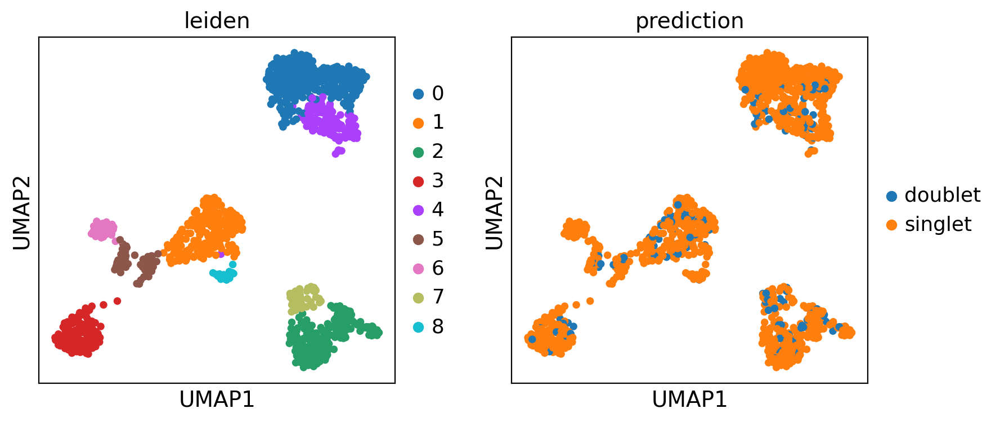

Ratón: Mouse_44
Total de células: 1266
Número de singletes: 1123 (88.70%)
Número de dobletes: 143 (11.30%)

Mouse_44: Total células filtradas: 1123


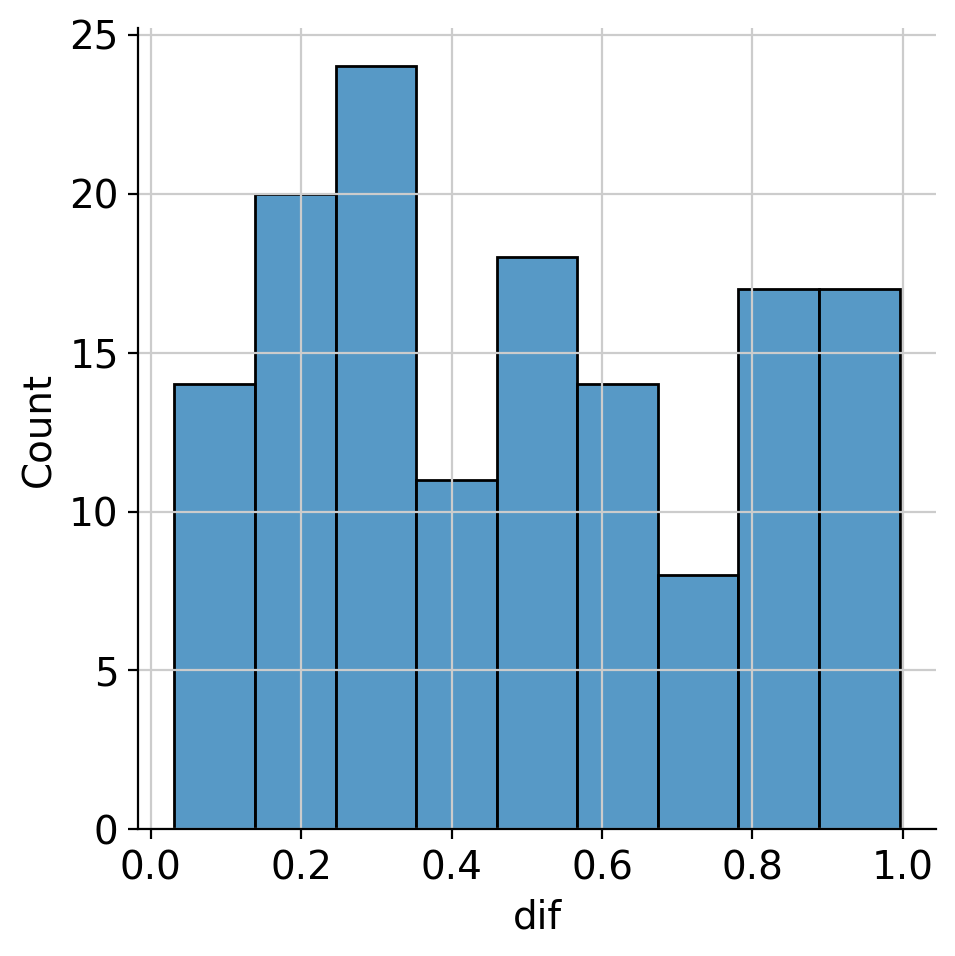

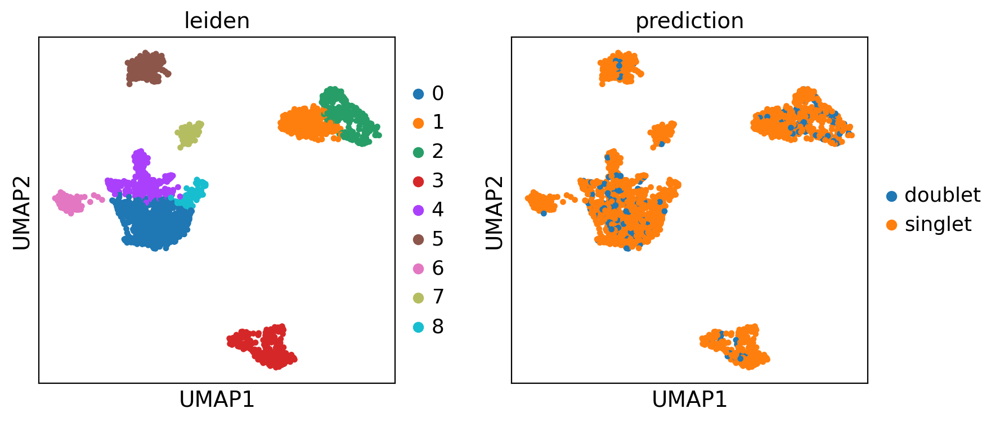

Ratón: Mouse_45
Total de células: 2005
Número de singletes: 1767 (88.13%)
Número de dobletes: 238 (11.87%)

Mouse_45: Total células filtradas: 1767


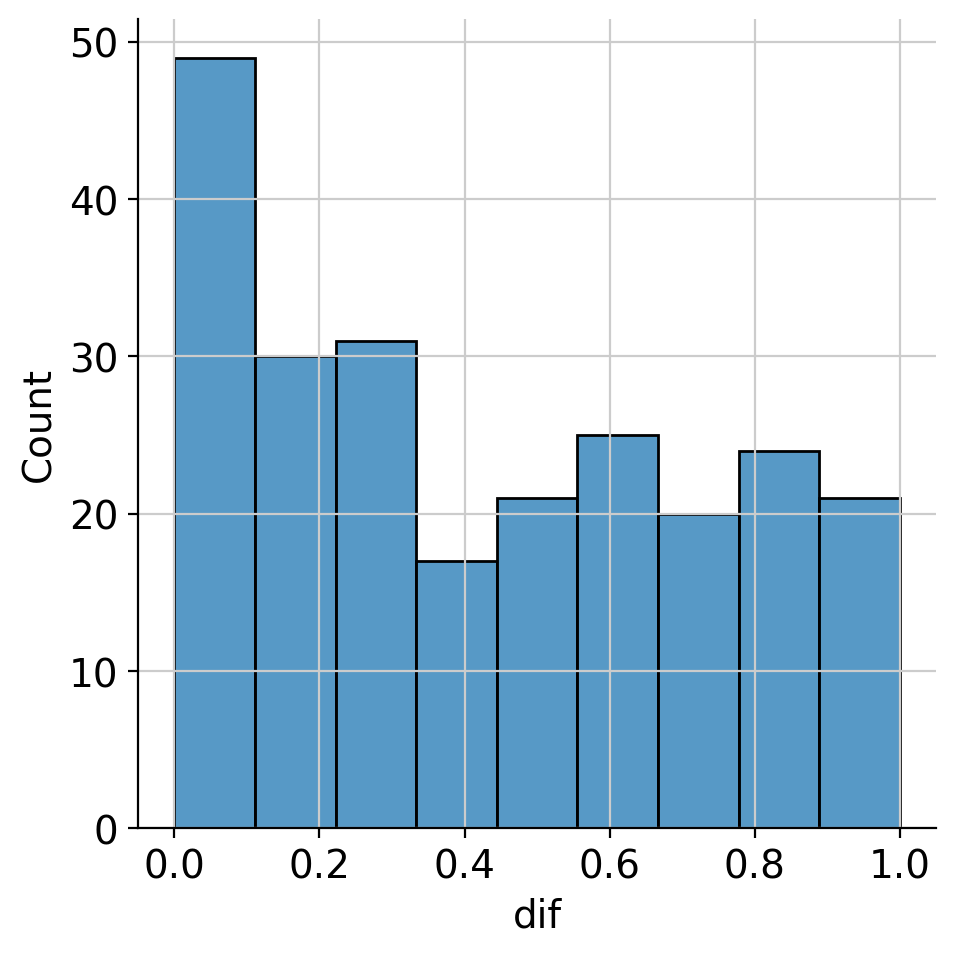

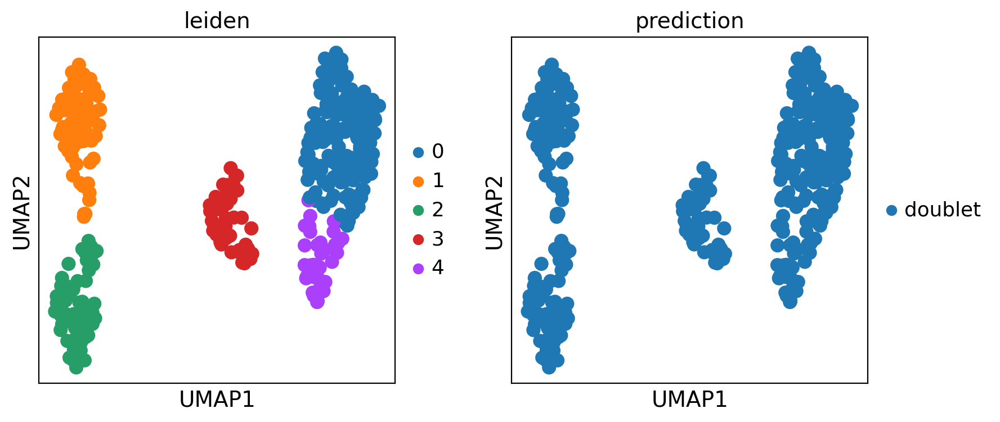

Ratón: Mouse_48
Total de células: 364
Número de singletes: 0 (0.00%)
Número de dobletes: 364 (100.00%)

Mouse_48: Total células filtradas: 0


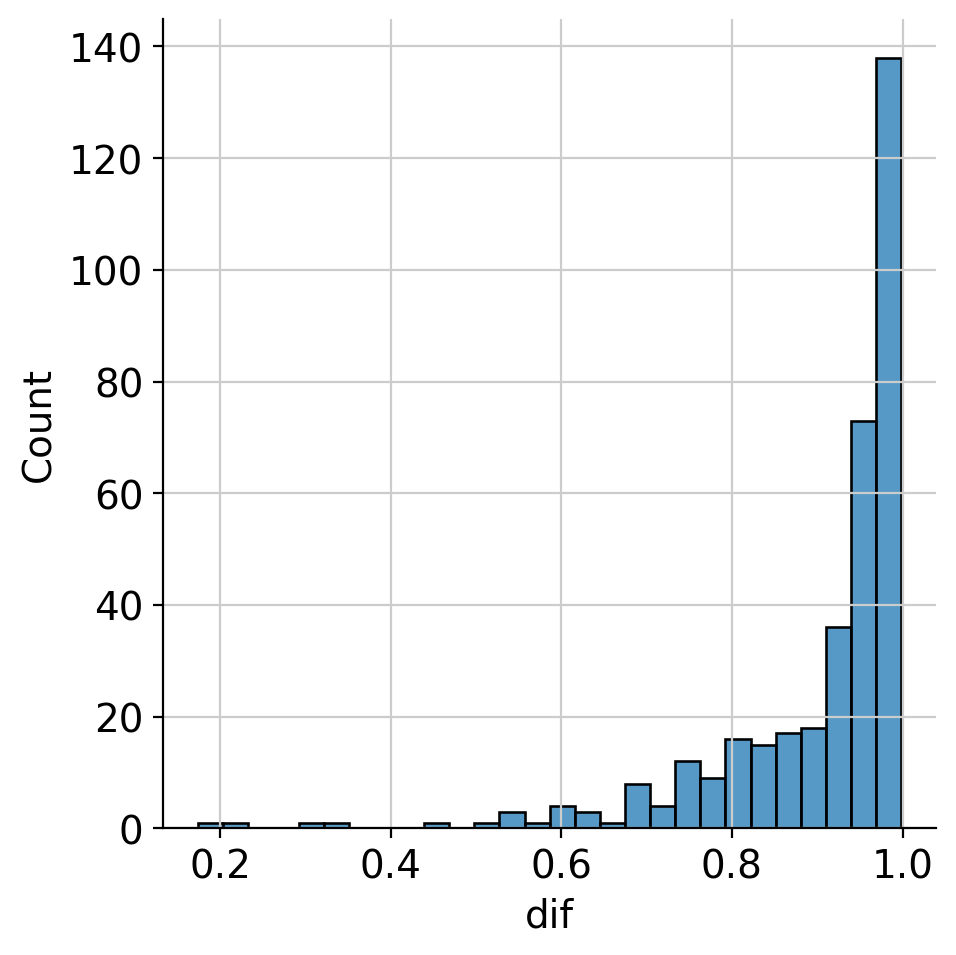

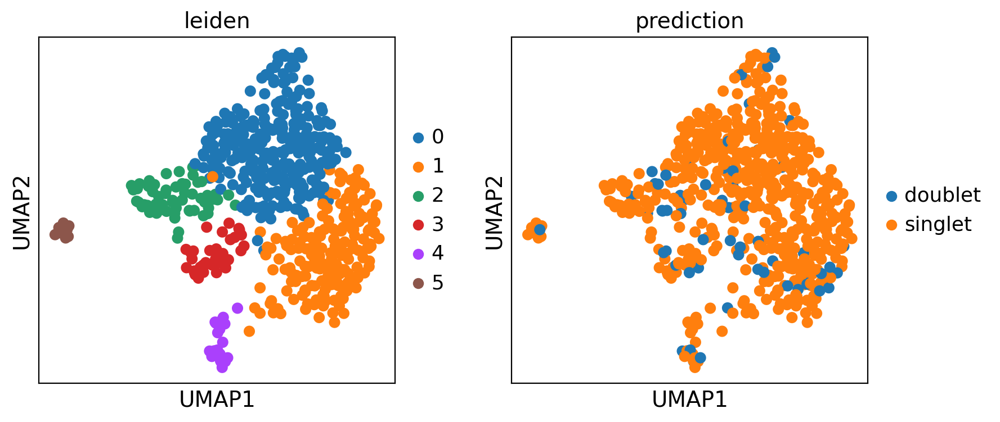

Ratón: Mouse_49
Total de células: 576
Número de singletes: 517 (89.76%)
Número de dobletes: 59 (10.24%)

Mouse_49: Total células filtradas: 517


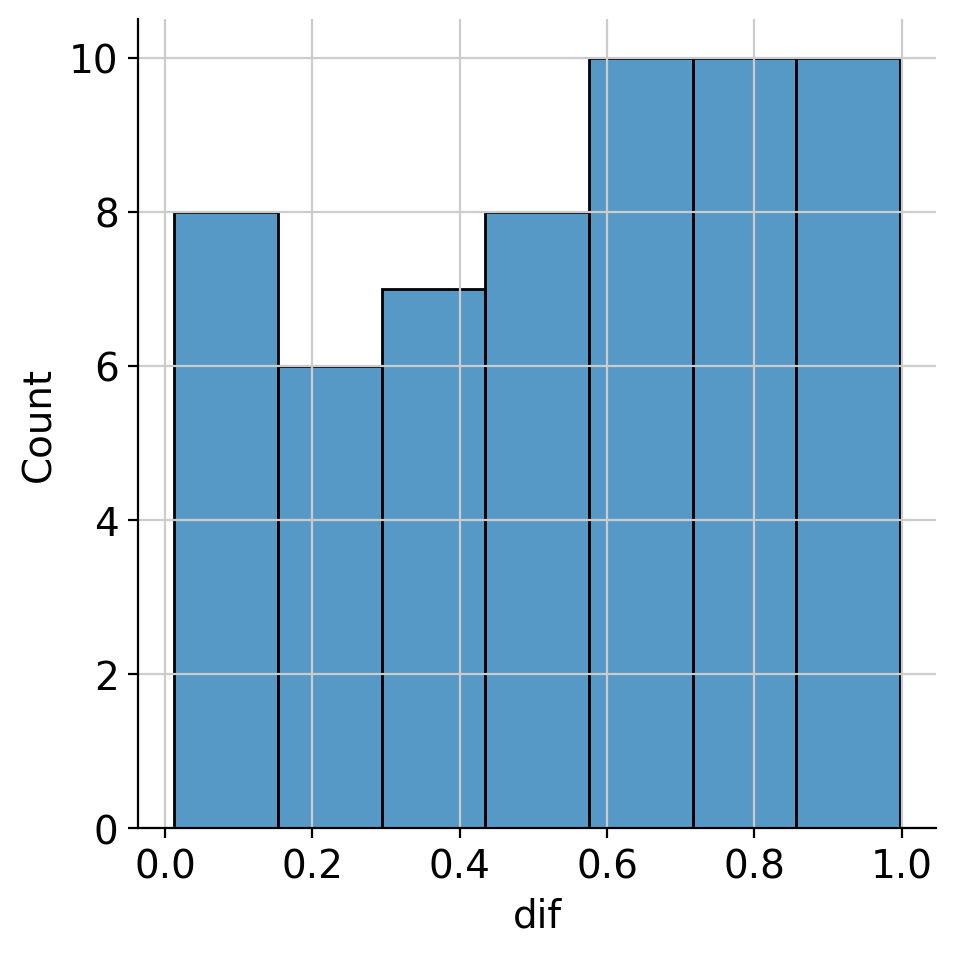

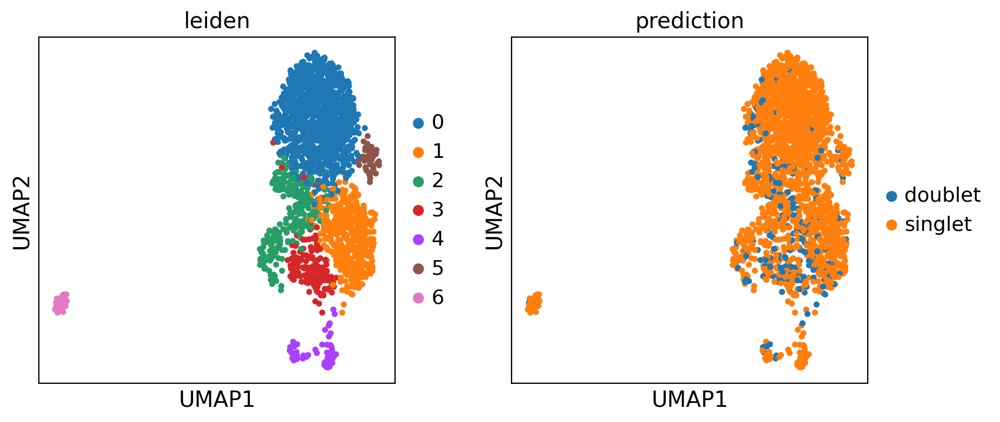

Ratón: Mouse_50
Total de células: 1988
Número de singletes: 1777 (89.39%)
Número de dobletes: 211 (10.61%)

Mouse_50: Total células filtradas: 1777


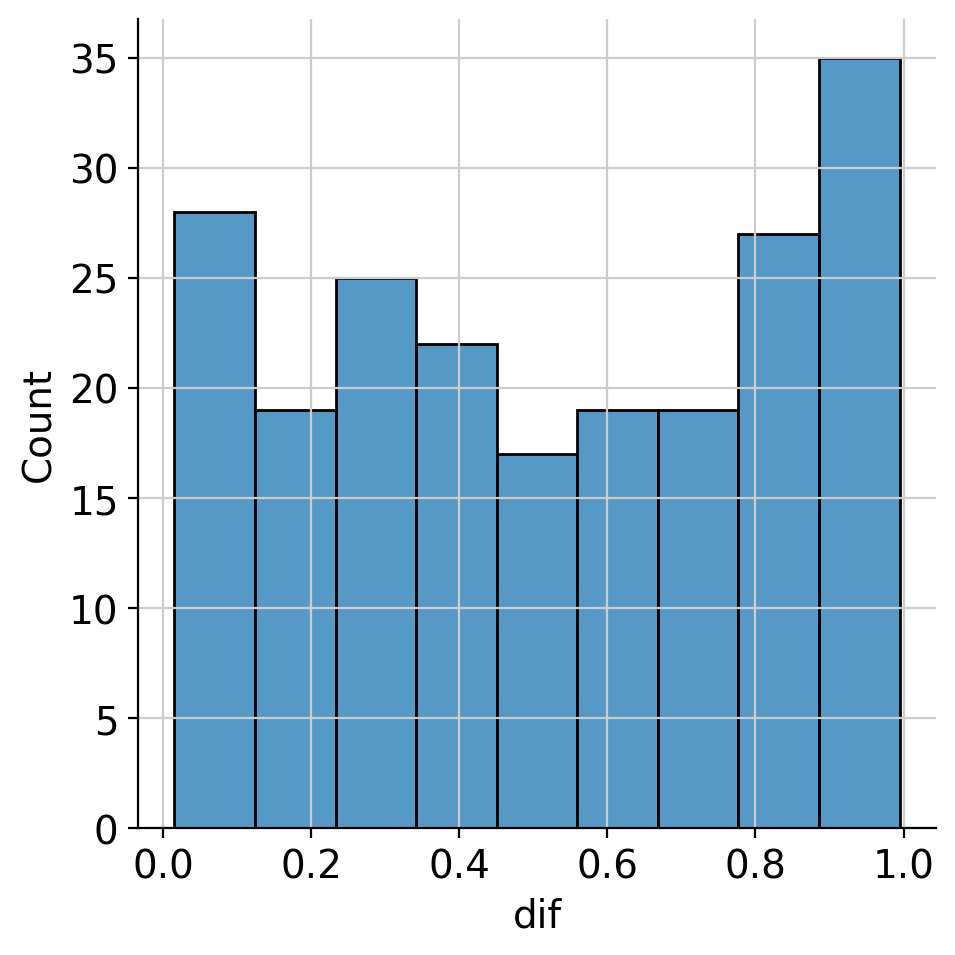

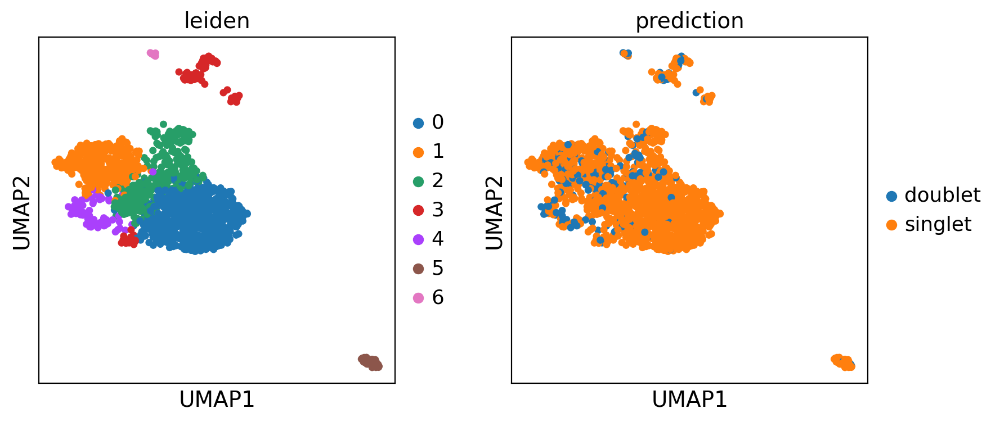

Ratón: Mouse_52
Total de células: 1354
Número de singletes: 1196 (88.33%)
Número de dobletes: 158 (11.67%)

Mouse_52: Total células filtradas: 1196


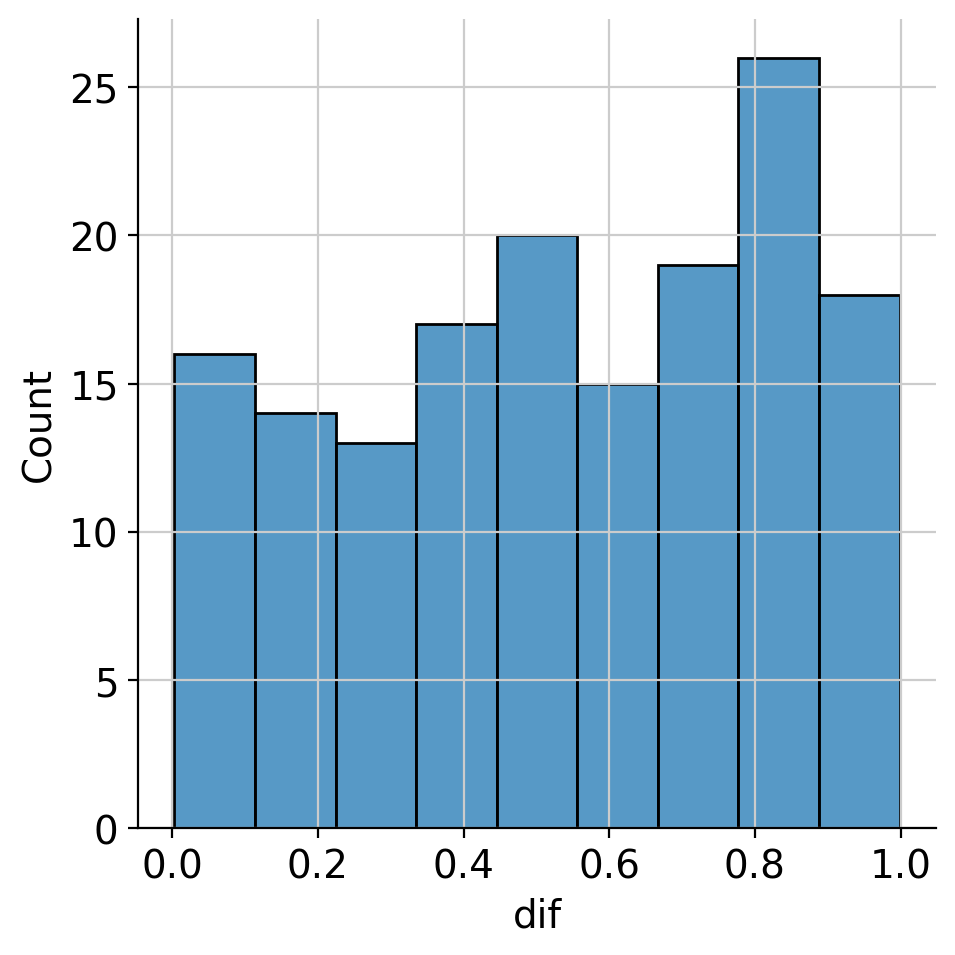

In [16]:
# CON LAS MATRICES LIMPIADAS POR SOUPX VEMOS LA DETECCION DE DOBLETES
import scanpy as sc
import pandas as pd
import seaborn as sns
from matplotlib.pyplot import rc_context

# Ruta base para las predicciones
prediction_base_path = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/predicciones_dobletes/"
output_base_path = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/"

# Lista de ratones y sus respectivos archivos AnnData corregidos por SoupX
mouse_data = {
    "Mouse_44": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_44_corrected_SoupX.h5ad"),
    "Mouse_45": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_45_corrected_SoupX.h5ad"),
    "Mouse_48": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_48_corrected_SoupX.h5ad"),
    "Mouse_49": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_49_corrected_SoupX.h5ad"),
    "Mouse_50": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_50_corrected_SoupX.h5ad"),
    "Mouse_52": sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/matrices_corregidas_SoupX/Mouse_52_corrected_SoupX.h5ad")
}

# Definir los umbrales para cada ratón (ajusta según lo necesites)
thresholds = {
    "Mouse_44": 0.0,  # Ajusta este valor después de inspeccionar los histogramas
    "Mouse_45": 0.0,  # Ajusta este valor
    "Mouse_48": 0.0,  # Ajusta este valor
    "Mouse_49": 0.0,  # Ajusta este valor
    "Mouse_50": 0.0,  # Ajusta este valor
    "Mouse_52": 0.0   # Ajusta este valor
}

# Aplicar las predicciones de SOLO a cada ratón
for mouse_name, adata in mouse_data.items():
    # Cargar el DataFrame de predicciones SOLO
    df = pd.read_csv(f"{prediction_base_path}{mouse_name}/solo_predictions_soupX.csv", index_col=0)
    
    # Añadir la predicción al objeto AnnData para visualización
    adata.obs['prediction'] = df['prediction']
    
    # Preprocesamiento para visualización
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.tl.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=0.5)
    
    # Visualización en UMAP
    with rc_context({'figure.figsize': (4, 4)}):
        sc.pl.umap(adata, color=['leiden', 'prediction'])
    
    # Crear un diccionario con las predicciones de dobletes
    doublet_d = dict(zip(df.index, df['prediction']))
    
    # Definir una función para mapear las predicciones
    def im_a_function(x):
        try:
            return doublet_d[x]
        except KeyError:
            return 'filtered'
    
    # Mapear las predicciones de dobletes
    adata.obs['doublet'] = adata.obs.index.map(im_a_function)
    
    # Contar células con y sin dobletes
    num_doublets = (adata.obs['doublet'] == 'doublet').sum()
    num_singlets = (adata.obs['doublet'] == 'singlet').sum()
    total_cells = adata.shape[0]
    
    print(f"Ratón: {mouse_name}")
    print(f"Total de células: {total_cells}")
    print(f"Número de singletes: {num_singlets} ({num_singlets / total_cells * 100:.2f}%)")
    print(f"Número de dobletes: {num_doublets} ({num_doublets / total_cells * 100:.2f}%)\n")
    
    # Calcular la diferencia entre la probabilidad de ser doblete y singlete
    df['dif'] = df['doublet'] - df['singlet']
    
    # Visualizar la distribución de 'dif' para los dobletes
    sns.displot(df[df['prediction'] == 'doublet'], x='dif')
    
    # Filtrar basado en el umbral decidido
    threshold = thresholds[mouse_name]
    doublets_filtered = df[(df['prediction'] == 'doublet') & (df['dif'] > threshold)]
    
    # Mapear los dobletes filtrados al AnnData
    adata.obs['doublet_filtered'] = adata.obs.index.isin(doublets_filtered.index)
    
    # Filtrar las células para quedarse solo con los singletes según el umbral
    adata_filtered = adata[~adata.obs['doublet_filtered']]
    
    # Guardar el AnnData filtrado sin dobletes
    adata_filtered.write_h5ad(f"{output_base_path}/{mouse_name}_sin_doubletes.h5ad")
    
    print(f"{mouse_name}: Total células filtradas: {adata_filtered.shape[0]}")



PREPROCESO DE LAS MATRICES LIMPIAS DE mRNA AMBIENTAL y sin dobletes

In [17]:
# Cargar las matrices filtradas sin dobletes para cada ratón
mouse_44_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_44_sin_doubletes.h5ad")
mouse_45_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_45_sin_doubletes.h5ad")
mouse_48_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_48_sin_doubletes.h5ad")
mouse_49_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_49_sin_doubletes.h5ad")
mouse_50_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_50_sin_doubletes.h5ad")
mouse_52_filtered = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Datos_sin_dobletes/Mouse_52_sin_doubletes.h5ad")

# Concatenar los objetos AnnData
adata = ad.concat(
    [mouse_44_filtered, mouse_45_filtered, mouse_48_filtered, mouse_49_filtered, mouse_50_filtered, mouse_52_filtered],
    label="Sample",  # Añadir columna que indica el origen de cada celda
    keys=["Mouse_44", "Mouse_45", "Mouse_48", "Mouse_49", "Mouse_50", "Mouse_52"],
    join="outer"  # Para incluir todas las variables
)

# Mostrar la estructura del objeto concatenado
print(adata)

AnnData object with n_obs × n_vars = 6380 × 32285
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'prediction', 'leiden', 'doublet', 'doublet_filtered', 'Sample'
    obsm: 'X_pca', 'X_umap'
    layers: 'raw_counts', 'soupX_counts'


In [18]:
adata

AnnData object with n_obs × n_vars = 6380 × 32285
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'prediction', 'leiden', 'doublet', 'doublet_filtered', 'Sample'
    obsm: 'X_pca', 'X_umap'
    layers: 'raw_counts', 'soupX_counts'

A PARTIR DE AQUI HACEMOS EL PREPROCESAMIENTO

In [19]:
def qc(adata):
    # Filtrar células con un número mínimo de genes
    #sc.pp.filter_cells(adata, min_genes=200)
    
    # Filtrar genes que no están expresados en al menos 3 células
    #sc.pp.filter_genes(adata, min_cells=3)
    
    # Anotar genes mitocondriales, ribosomales y de hemoglobina
    adata.var["mt"] = adata.var_names.str.startswith("mt-")  # Mitocondriales empiezan con 'mt-'
    adata.var["ribo"] = adata.var_names.str.startswith(("Rps", "Rpl"))  # Ribosomales empiezan con 'Rps' o 'Rpl'
    adata.var["hb"] = adata.var_names.str.startswith("Hb")  # Hemoglobina empieza con 'Hb'
    
    # Calcular métricas de QC
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True)
    
    return adata

In [20]:
adata = qc(adata)

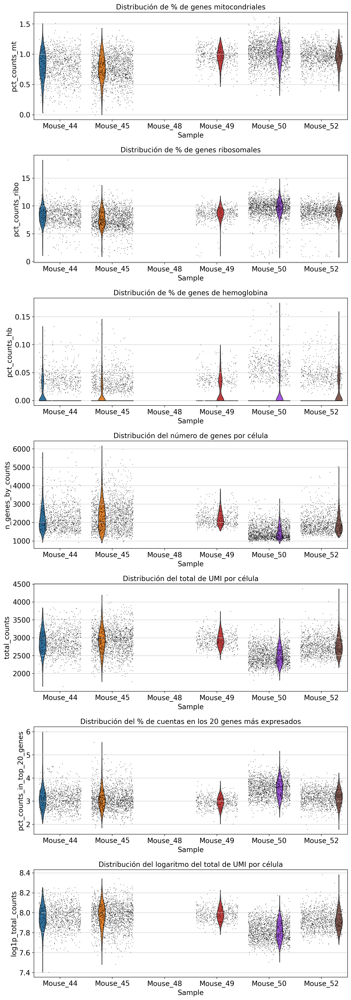

In [22]:
import scanpy as sc
import matplotlib.pyplot as plt

# Crear una figura con subplots para cada métrica
fig, axes = plt.subplots(7, 1, figsize=(10, 28))  # 7 filas, 1 columna

# Generar los violin plots individualmente para cada métrica
sc.pl.violin(adata, "pct_counts_mt", groupby="Sample", jitter=0.4, ax=axes[0], show=False)
axes[0].set_title("Distribución de % de genes mitocondriales")

sc.pl.violin(adata, "pct_counts_ribo", groupby="Sample", jitter=0.4, ax=axes[1], show=False)
axes[1].set_title("Distribución de % de genes ribosomales")

sc.pl.violin(adata, "pct_counts_hb", groupby="Sample", jitter=0.4, ax=axes[2], show=False)
axes[2].set_title("Distribución de % de genes de hemoglobina")

sc.pl.violin(adata, "n_genes_by_counts", groupby="Sample", jitter=0.4, ax=axes[3], show=False)
axes[3].set_title("Distribución del número de genes por célula")

sc.pl.violin(adata, "total_counts", groupby="Sample", jitter=0.4, ax=axes[4], show=False)
axes[4].set_title("Distribución del total de UMI por célula")

sc.pl.violin(adata, "pct_counts_in_top_20_genes", groupby="Sample", jitter=0.4, ax=axes[5], show=False)
axes[5].set_title("Distribución del % de cuentas en los 20 genes más expresados")

sc.pl.violin(adata, "log1p_total_counts", groupby="Sample", jitter=0.4, ax=axes[6], show=False)
axes[6].set_title("Distribución del logaritmo del total de UMI por célula")

# Ajustar los espacios entre subplots
plt.tight_layout()
plt.show()


In [23]:
#Hacemos primero la limpieza de los outliers con el median absolute deviation (MAD)
from scipy.stats import median_abs_deviation as mad

# Función MAD para identificar outliers
def mad_outlier(adata, metric, nmads, upper_only=False):
    M = adata.obs[metric]
    if not upper_only:
        return (M < np.median(M) - nmads * mad(M)) | (M > np.median(M) + nmads * mad(M))
    return (M > np.median(M) + nmads * mad(M))

# Función de preprocesamiento utilizando MAD
def pp_mad(adata):
    # Filtrado inicial por porcentaje de genes mitocondriales
    adata = adata[adata.obs.pct_counts_mt < 10]
    
    # Filtrado por MAD en varias métricas
    bool_vector = mad_outlier(adata, 'log1p_total_counts', 5) + \
                  mad_outlier(adata, 'log1p_n_genes_by_counts', 5) + \
                  mad_outlier(adata, 'pct_counts_in_top_20_genes', 5) + \
                  mad_outlier(adata, 'pct_counts_mt', 3, upper_only=True)
    
    # Aplicar filtro
    adata = adata[~bool_vector]

    # Almacenar el número de células eliminadas
    adata.uns['cells_removed'] = sum(bool_vector)

    return adata

# Función de preprocesamiento utilizando límites estándar
def pp_standard(adata):
    # Filtrar por número mínimo de genes detectados
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)
    # Filtrar por porcentaje de genes mitocondriales
    adata = adata[adata.obs.pct_counts_mt < 10]
    
    # Filtrar por límite superior del número de genes detectados
    upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
    adata = adata[adata.obs.n_genes_by_counts < upper_lim]
    
    # Filtrar por porcentaje de genes ribosomales
    adata = adata[adata.obs.pct_counts_ribo < 40]

    return adata


In [24]:
# Función de preprocesamiento mixto
def pp_mixto(adata, gene_limit=4000, mt_percent=10, ribo_percent=40, min_genes=200, min_cells=3):
    # Filtrar células con un número mínimo de genes
    sc.pp.filter_cells(adata, min_genes=min_genes)
    
    # Filtrar genes que no están expresados en al menos 3 células
    sc.pp.filter_genes(adata, min_cells=min_cells)
    
    # Filtrar por porcentaje de genes mitocondriales
    adata = adata[adata.obs.pct_counts_mt < mt_percent]
    
    # Filtrar por límite superior del número de genes detectados
    adata = adata[adata.obs.n_genes_by_counts < gene_limit]
    
    # Filtrar por porcentaje de genes ribosomales
    adata = adata[adata.obs.pct_counts_ribo < ribo_percent]
    
    # Aplicar filtrado MAD en otras métricas
    bool_vector = mad_outlier(adata, 'log1p_total_counts', 5) + \
                  mad_outlier(adata, 'log1p_n_genes_by_counts', 5) + \
                  mad_outlier(adata, 'pct_counts_in_top_20_genes', 5)
    
    # Aplicar filtro
    adata = adata[~bool_vector]

    # Almacenar el número de células eliminadas
    adata.uns['cells_removed'] = sum(bool_vector)

    return adata

In [28]:
# Excluir Mouse_48 de la lista de matrices
adata_list = [mouse_44_filtered, mouse_45_filtered, mouse_49_filtered, mouse_50_filtered, mouse_52_filtered]

# Aplicar la función QC a las matrices filtradas
adata_list = [qc(adata) for adata in adata_list]

# Listas para almacenar los resultados filtrados
adata_list_mad = []
adata_list_standard = []
adata_list_mixto = []

# Aplicar el filtrado utilizando MAD, estándar y mixto a cada ratón
for adata in adata_list:
    adata_mad = pp_mad(adata.copy())
    adata_standard = pp_standard(adata.copy())
    adata_mixto = pp_mixto(adata.copy())
    
    adata_list_mad.append(adata_mad)
    adata_list_standard.append(adata_standard)
    adata_list_mixto.append(adata_mixto)

In [63]:
# Concatenar los datos y añadir un identificador de origen ("Sample")
adata_concat_mad = ad.concat(adata_list_mad, label="Sample", keys=["Mouse_44", "Mouse_45", "Mouse_49", "Mouse_50", "Mouse_52"])
adata_concat_standard = ad.concat(adata_list_standard, label="Sample", keys=["Mouse_44", "Mouse_45", "Mouse_49", "Mouse_50", "Mouse_52"])
adata_concat_mixto = ad.concat(adata_list_mixto, label="Sample", keys=["Mouse_44", "Mouse_45", "Mouse_49", "Mouse_50", "Mouse_52"])

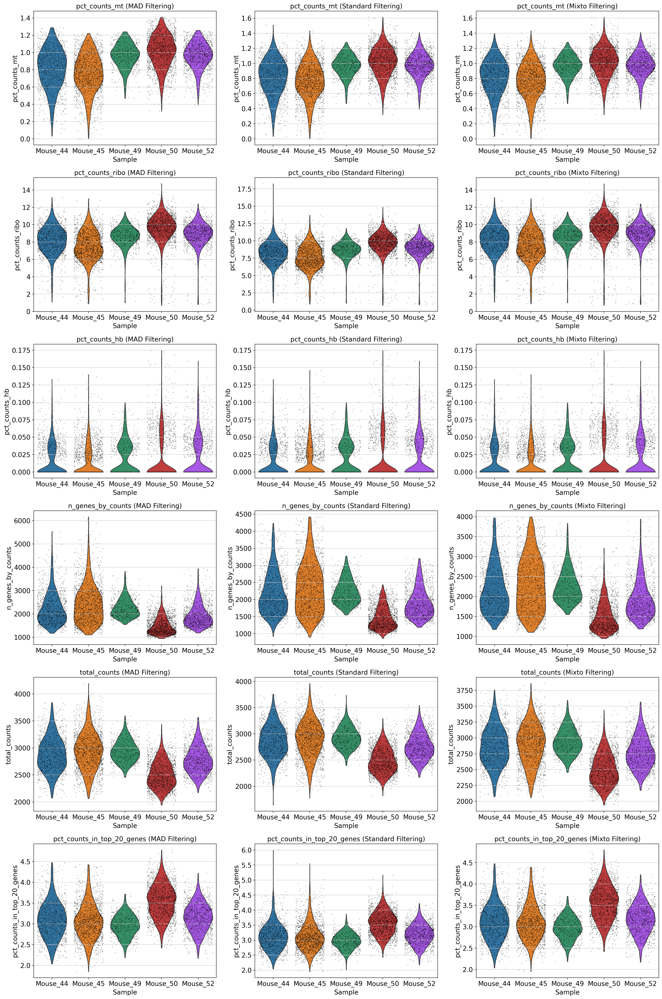

In [30]:
# Métricas a comparar
metrics = ["pct_counts_mt", "pct_counts_ribo", "pct_counts_hb", "n_genes_by_counts", "total_counts", "pct_counts_in_top_20_genes"]

# Crear una figura con subplots para comparar los métodos de filtrado
fig, axes = plt.subplots(len(metrics), 3, figsize=(20, len(metrics) * 5))

for i, metric in enumerate(metrics):
    # Violin plot para el método MAD
    sc.pl.violin(adata_concat_mad, metric, groupby="Sample", jitter=0.4, ax=axes[i, 0], show=False)
    axes[i, 0].set_title(f"{metric} (MAD Filtering)")

    # Violin plot para el método estándar
    sc.pl.violin(adata_concat_standard, metric, groupby="Sample", jitter=0.4, ax=axes[i, 1], show=False)
    axes[i, 1].set_title(f"{metric} (Standard Filtering)")
    
    # Violin plot para el método mixto
    sc.pl.violin(adata_concat_mixto, metric, groupby="Sample", jitter=0.4, ax=axes[i, 2], show=False)
    axes[i, 2].set_title(f"{metric} (Mixto Filtering)")

# Ajustar los espacios entre subplots
plt.tight_layout()
plt.show()

In [33]:
# Guardar los datos filtrados con el método mixto
output_dir = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/filtered_matrices_qc"

# Crear el directorio si no existe
os.makedirs(output_dir, exist_ok=True)

# Lista de nombres de muestras correctas
sample_names = ["Mouse_44", "Mouse_45", "Mouse_49", "Mouse_50", "Mouse_52"]

# Guardar cada matriz con su nombre correspondiente
for sample_name, adata in zip(sample_names, adata_list_mixto):
    adata.write_h5ad(f"{output_dir}/{sample_name}_filtered_QC_mixto.h5ad")


In [65]:
#seguimos con el concatenado y como tenemos el counts vamos a normalizar
adata_concat_mixto.layers['counts'] = adata_concat_mixto.X.copy()

In [66]:
adata_concat_mixto.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,prediction,leiden,doublet,doublet_filtered,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,n_genes,Sample
AAACCTGCAGTAAGAT-1,2902,7.973500,3033.804968,8.017902,2.998142,14.935190,2.768530,0.492292,singlet,3,singlet,False,204.400215,5.324960,6.737421,1.039506,0.712708,0.034264,2902,Mouse_44
AAACGGGGTTATTCTC-1,2556,7.846590,2924.591928,7.981252,3.031418,31.153281,3.470514,1.065218,singlet,0,singlet,False,261.516194,5.570313,8.941972,0.775549,0.574110,0.026518,2556,Mouse_44
AAAGATGAGAGATGAG-1,1883,7.541152,2812.126773,7.942052,3.126140,25.963298,3.294477,0.923262,singlet,4,singlet,False,247.903572,5.517066,8.815519,0.000000,0.000000,0.000000,1883,Mouse_44
AAAGATGCACCTATCC-1,1402,7.246368,2385.745753,7.777686,3.960901,30.620537,3.453807,1.283479,singlet,1,singlet,False,191.137792,5.258213,8.011658,0.000000,0.000000,0.000000,1402,Mouse_44
AAAGATGGTCCTCCAT-1,1773,7.480992,2658.427295,7.885866,3.320345,30.417217,3.447356,1.144181,singlet,0,singlet,False,256.143169,5.549633,9.635139,0.000000,0.000000,0.000000,1773,Mouse_44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCATCGACGC-1,2077,7.639161,3168.422936,8.061305,2.539929,16.779035,2.878020,0.529571,singlet,3,singlet,False,100.341618,4.618497,3.166926,1.226947,0.800632,0.038724,2077,Mouse_52
TTTGGTTGTAAACGCG-1,1522,7.328437,2633.780928,7.876555,3.194816,31.310510,3.475393,1.188805,singlet,0,singlet,False,199.359899,5.300115,7.569342,0.000000,0.000000,0.000000,1522,Mouse_52
TTTGGTTGTAAAGGAG-1,1889,7.544332,2729.020561,7.912064,3.257831,26.271707,3.305850,0.962679,singlet,0,singlet,False,245.343450,5.506727,8.990165,0.000000,0.000000,0.000000,1889,Mouse_52
TTTGGTTGTGTTCGAT-1,1602,7.379632,2365.775952,7.769284,3.963225,22.966485,3.176656,0.970780,singlet,1,singlet,False,285.898470,5.659128,12.084765,1.130252,0.756240,0.047775,1602,Mouse_52


NORMALIZACIÓN DE LOS DATOS

In [35]:
sc.pp.normalize_total(adata_concat_mixto, target_sum=1e4)
sc.pp.log1p(adata_concat_mixto)
adata_concat_mixto.raw = adata_concat_mixto

In [36]:
sc.pp.highly_variable_genes(adata_concat_mixto, n_top_genes=3000,subset=True,layer='counts',flavor="seurat_v3",batch_key="Sample")

In [37]:
# Guardar el objeto AnnData procesado después de aplicar el filtro mixto
adata_concat_mixto.write_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/processed_data/adata_mixto_processed.h5ad")


In [61]:
adata_concat_mixto

AnnData object with n_obs × n_vars = 6231 × 3000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'prediction', 'leiden', 'doublet', 'doublet_filtered', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'Sample'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Sample_colors', 'log1p', 'hvg'
    obsm: 'X_pca', 'X_umap'
    layers: 'raw_counts', 'soupX_counts', 'counts'

In [79]:
# scvi.model.SCVI.setup_anndata(adata_concat_mixto, layer = "counts",
#                              categorical_covariate_keys=["Sample"],
#                              continuous_covariate_keys=['pct_counts_mt', 'total_counts'])
# model = scvi.model.SCVI(adata_concat_mixto)
# model.train()

In [38]:
!sbatch /data/scratch/LAB/enric/TFM_enric/scripts_auxiliares_jupyter/scvi_modelo_general.sh

Submitted batch job 717010


In [24]:
adata = sc.read_h5ad("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/processed_data/adata_mixto_processed.h5ad")
# scvi.model.SCVI.setup_anndata(adata, layer='counts',
#                               categorical_covariate_keys=['Sample'],
#                               continuous_covariate_keys=['pct_counts_mt', 'total_counts', 'pct_counts_ribo'])
# # Cargar el modelo entrenado
model = scvi.model.SCVI.load("/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/modelos/modelo_general_scvi/vae_model/")

INFO     File                                                                                                      
         /data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/modelos/modelo_general_scvi/vae_model/model.
         pt already downloaded                                                                                     


In [25]:
latent = model.get_latent_representation() 

In [26]:
latent.shape

(6231, 10)

In [27]:
adata.obsm["X_scVI"] = latent

In [28]:
adata.layers['scVI_normalized'] = model.get_normalized_expression(library_size=1e4)

In [29]:
sc.pp.neighbors(adata,use_rep="X_scVI")
sc.tl.umap(adata)
sc.tl.leiden(adata,resolution=0.5)

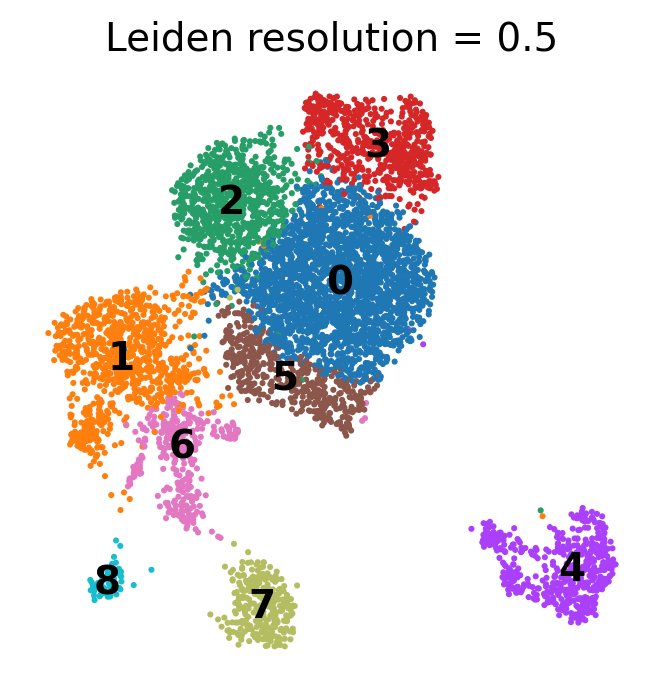

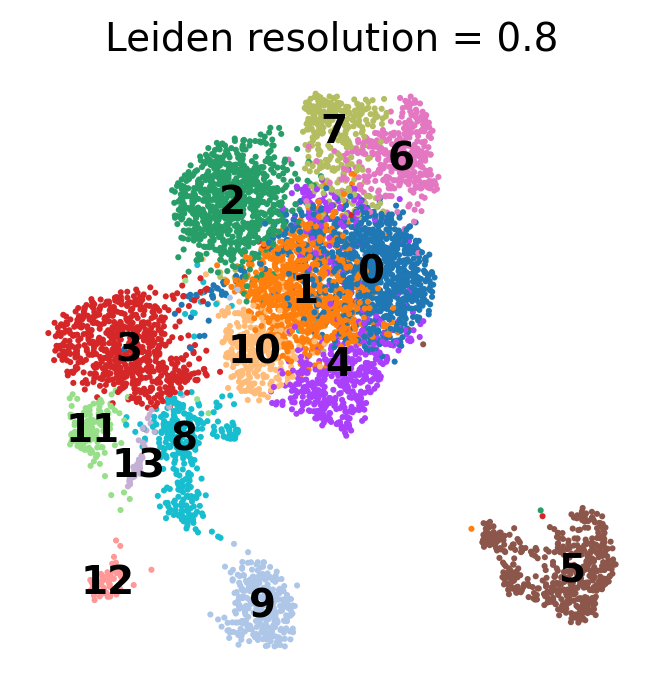

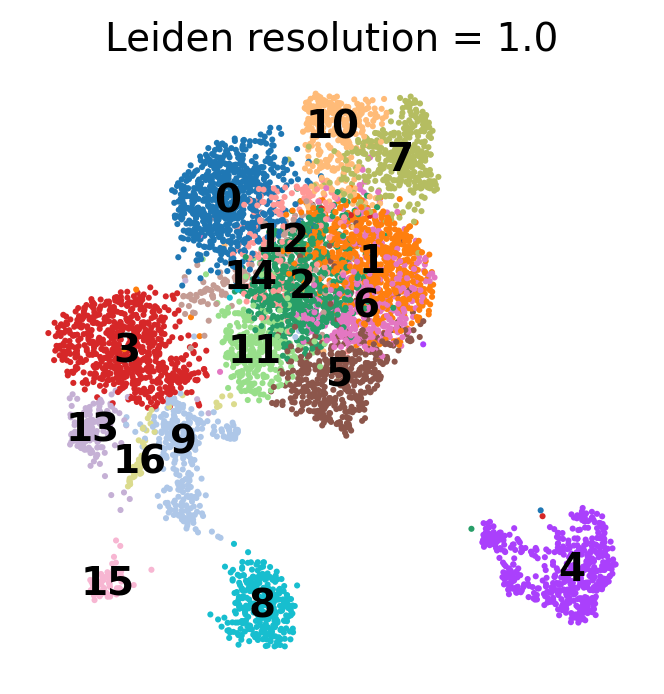

In [10]:
# Lista de resoluciones que quieres probar
resolutions = [0.5, 0.8, 1.0]

# Iterar sobre las resoluciones y calcular Leiden para cada una
for res in resolutions:
    leiden_key = f'leiden_{res}'  # Guardar el resultado con un nombre específico para cada resolución
    sc.tl.leiden(adata, resolution=res, key_added=leiden_key)
    
    # Visualizar el UMAP con el clustering de la resolución actual
    sc.pl.umap(adata, color=[leiden_key], frameon=False, legend_loc="on data", title=f'Leiden resolution = {res}')

# Opcional: Guarda el objeto AnnData si lo deseas
# adata.write('/ruta/donde/guardar/integrated_with_various_resolutions.h5ad')


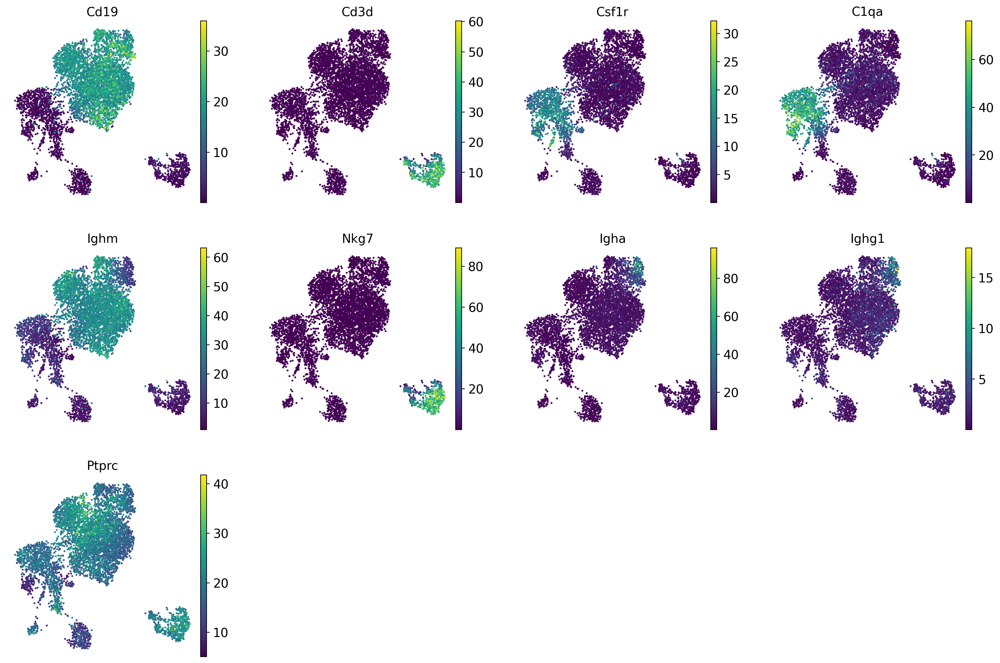

In [12]:
sc.pl.umap(adata,color=['Cd19','Cd3d',"Csf1r","C1qa","Ighm","Nkg7","Igha","Ighg1","Ptprc"], frameon= False, layer='scVI_normalized')

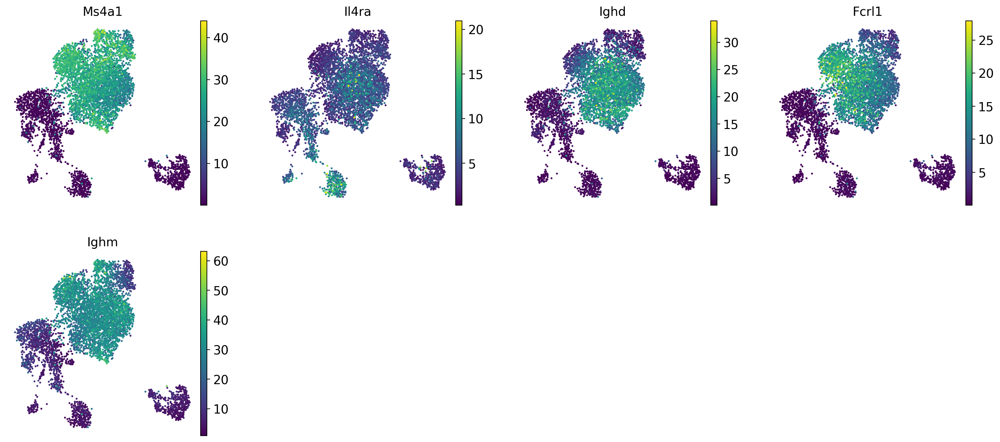

In [28]:
#NAIVE CD20+ B:
sc.pl.umap(adata,color=['Ms4a1','Il4ra','Ighd',"Fcrl1",'Ighm'], frameon= False, layer='scVI_normalized')

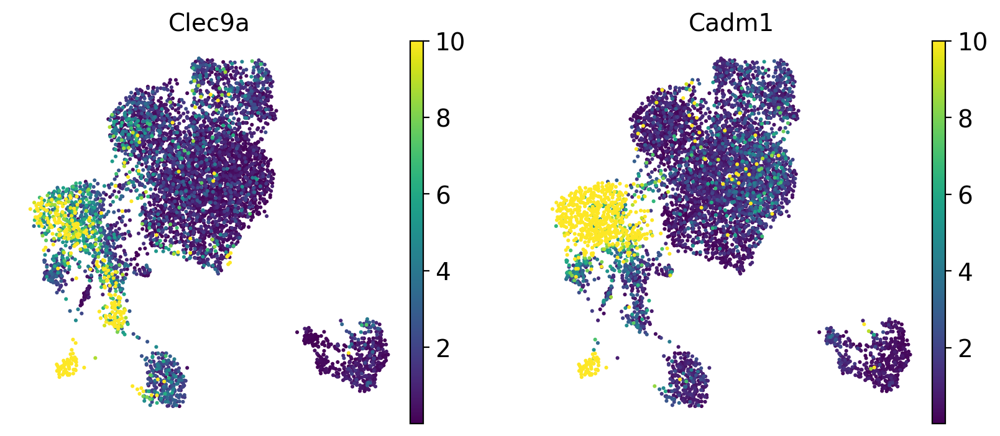

In [59]:
#cDC1
sc.pl.umap(adata,color=['Clec9a','Cadm1'], frameon= False, layer='scVI_normalized',vmax = 10)

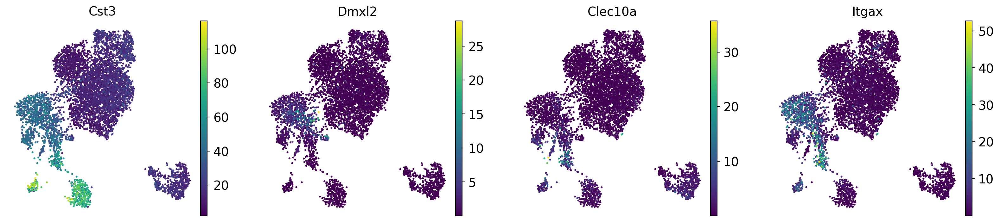

In [23]:
# Representación en UMAP para los marcadores de cDC2
sc.pl.umap(adata, color=['Cst3', 'Dmxl2', 'Clec10a','Itgax'], frameon=False, layer='scVI_normalized')

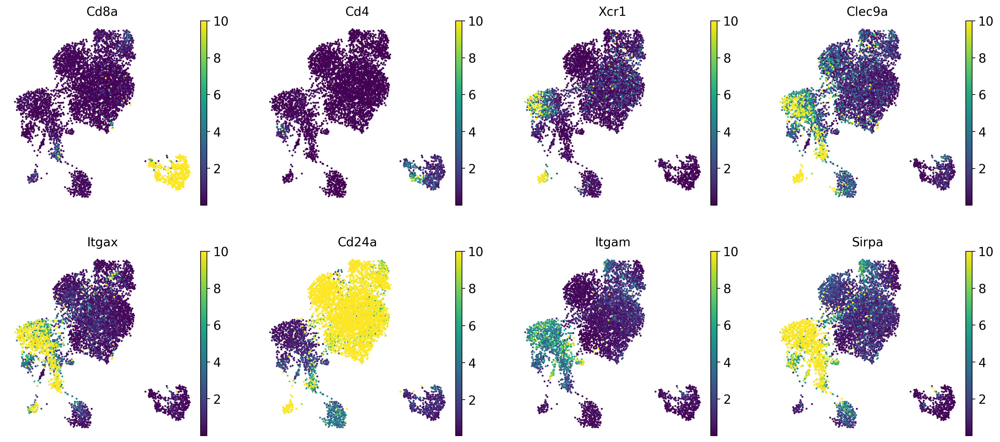

In [34]:
# Conventional DC
sc.pl.umap(adata, color=['Cd8a','Cd4','Xcr1', 'Clec9a','Itgax','Cd24a','Itgam','Sirpa'], frameon=False, layer='scVI_normalized',vmax =10)

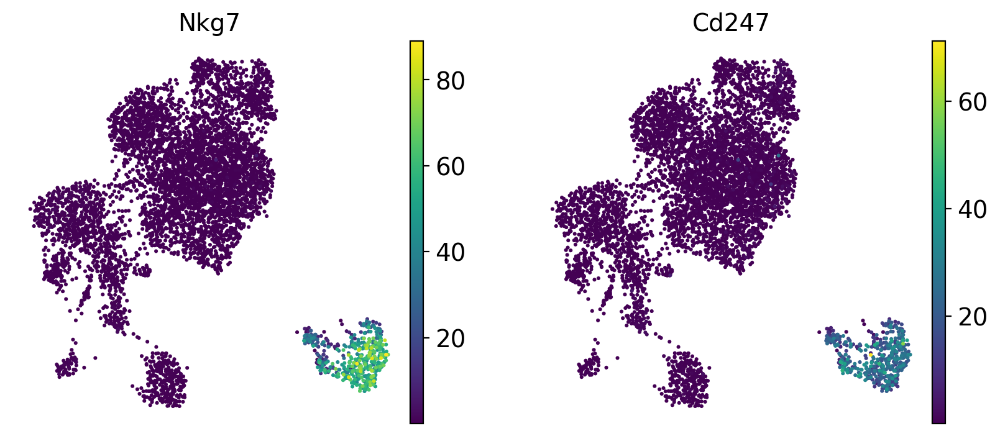

In [42]:
# Representación en UMAP para los marcadores de NK
sc.pl.umap(adata, color=['Nkg7', 'Cd247'], frameon=False, layer='scVI_normalized')


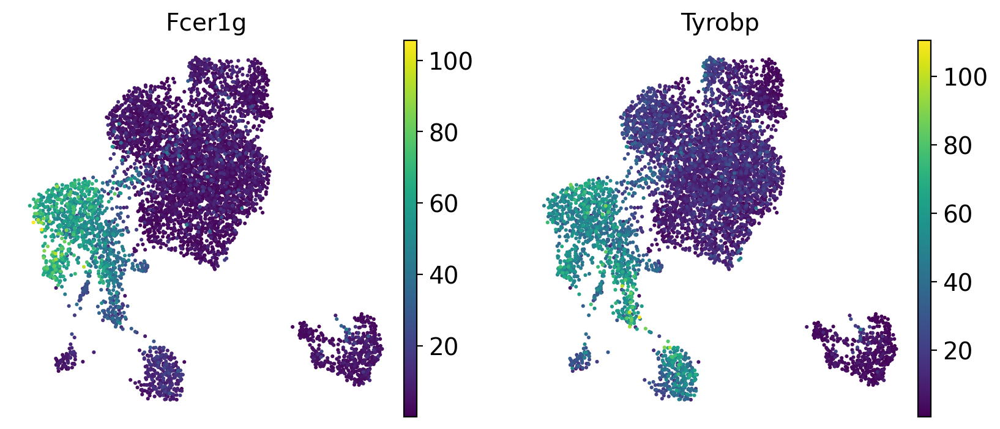

In [43]:
#macrophages
sc.pl.umap(adata, color=['Fcer1g', 'Tyrobp'], frameon=False, layer='scVI_normalized')

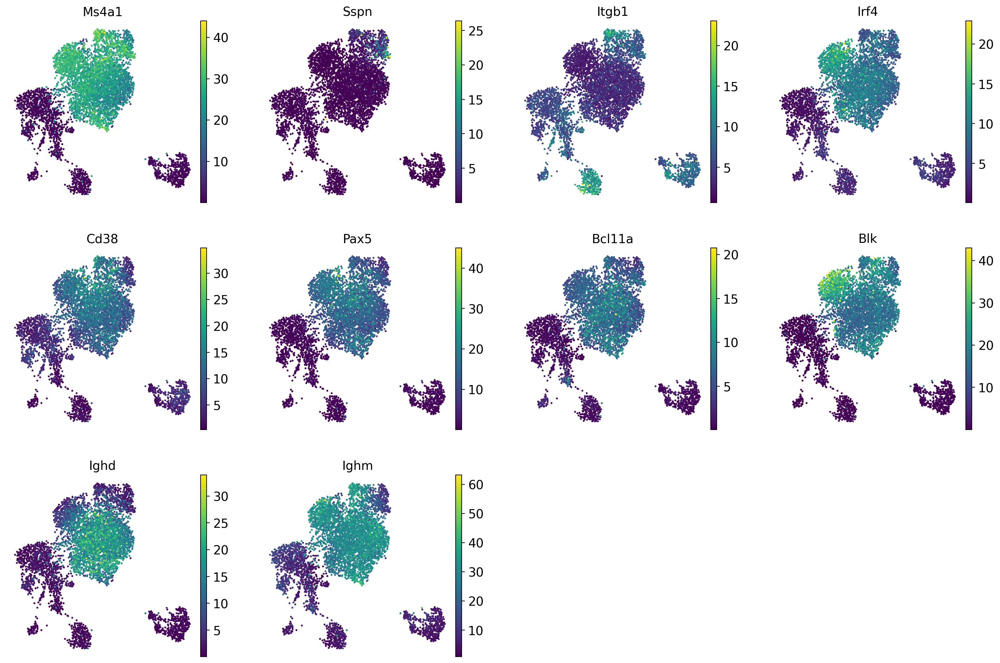

In [49]:
# Representación en UMAP para los marcadores de B1 B
sc.pl.umap(adata, color=['Ms4a1', 'Sspn', 'Itgb1','Irf4', 'Cd38', 'Pax5', 'Bcl11a', 'Blk', 'Ighd', 'Ighm'], frameon=False, layer='scVI_normalized')


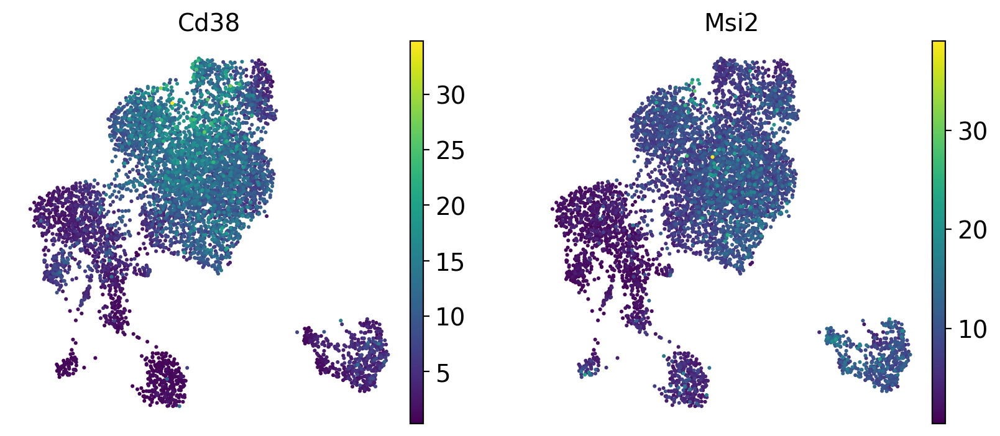

In [54]:
# Representación en UMAP para los marcadores de Transitional B
sc.pl.umap(adata, color=['Cd38', 'Msi2'], frameon=False, layer='scVI_normalized')


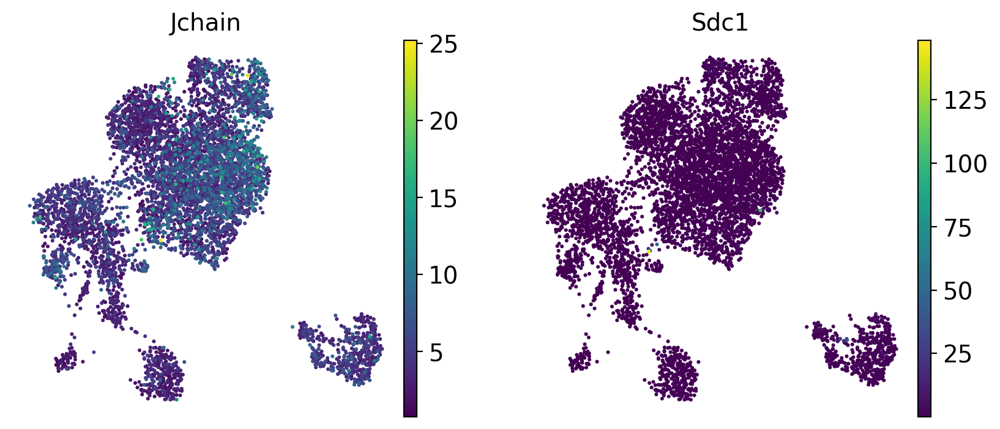

In [19]:
# Representación en UMAP para los marcadores de Plasma cells
sc.pl.umap(adata, color=['Jchain','Sdc1'], frameon=False, layer='scVI_normalized')

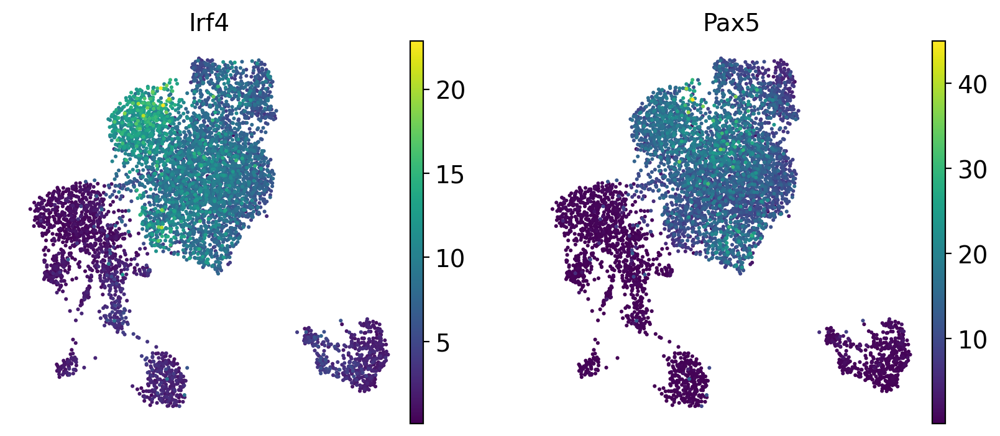

In [61]:
# Representación en UMAP para los marcadores de Plasmablast
sc.pl.umap(adata, color=['Irf4', 'Pax5'], frameon=False, layer='scVI_normalized')


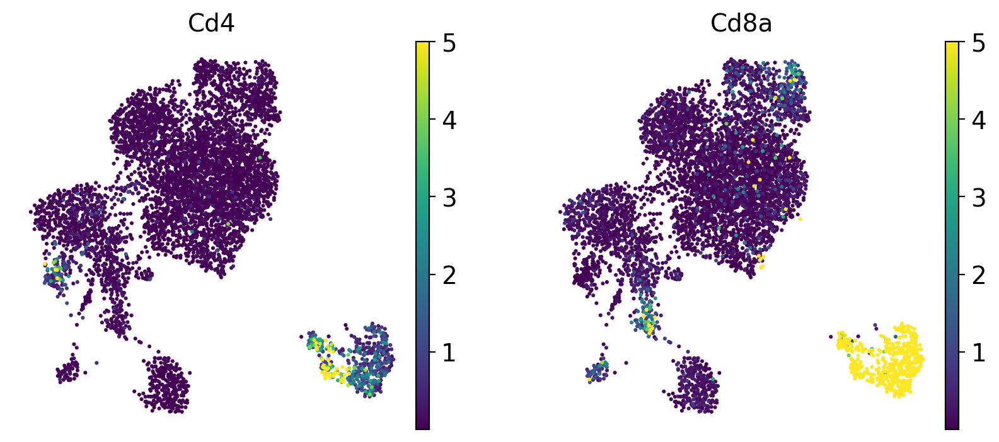

In [17]:
sc.pl.umap(adata, color = ['Cd4',"Cd8a"], frameon = False, layer = 'scVI_normalized', vmax = 5)

In [30]:
adata.write_h5ad('/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/data_integrated/integrated_with_leiden_and_markers.h5ad')

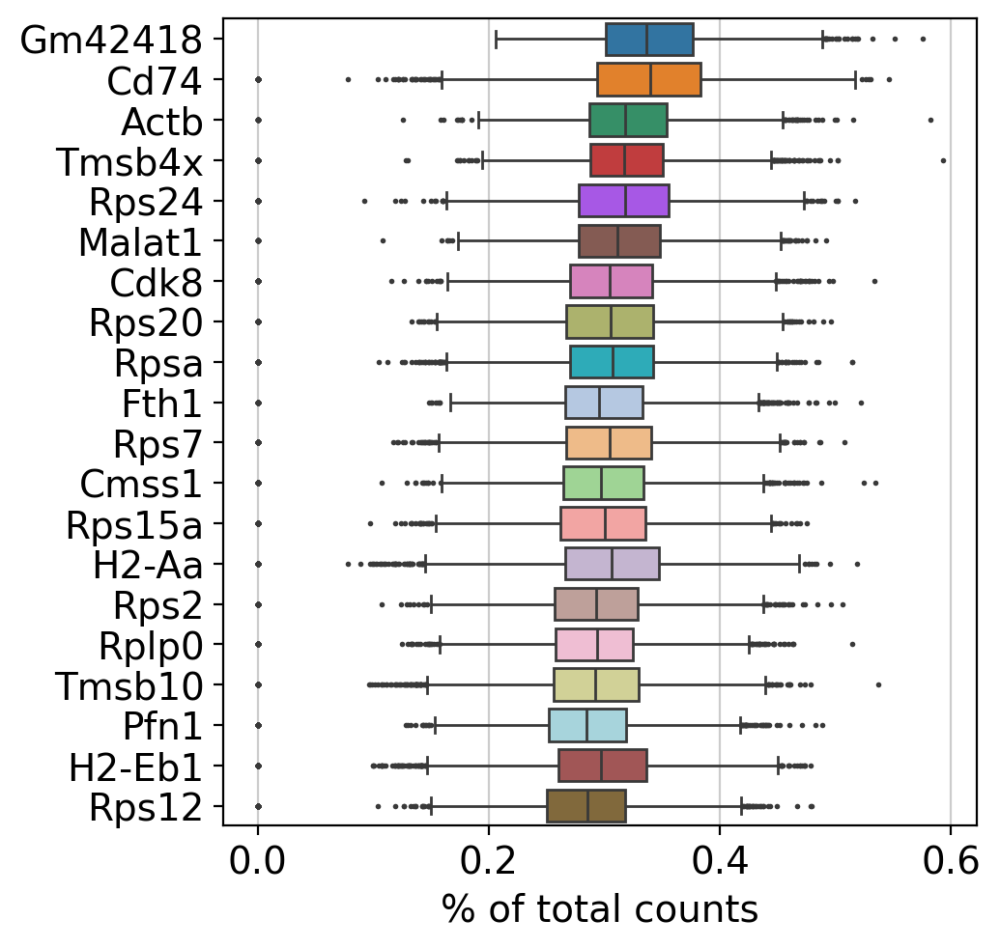

In [3]:
# Cargar el archivo AnnData
adata = sc.read_h5ad('/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/data_integrated/integrated_with_leiden_and_markers.h5ad')

# Visualizar los 20 genes más expresados
sc.pl.highest_expr_genes(adata, n_top=20)

In [32]:
adata

AnnData object with n_obs × n_vars = 6231 × 3000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'prediction', 'leiden', 'doublet', 'doublet_filtered', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'Sample'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Sample_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'counts', 'raw_counts', 'scVI_normalized', 'soupX_counts'
    obsp: 'connectivities', 'distances'

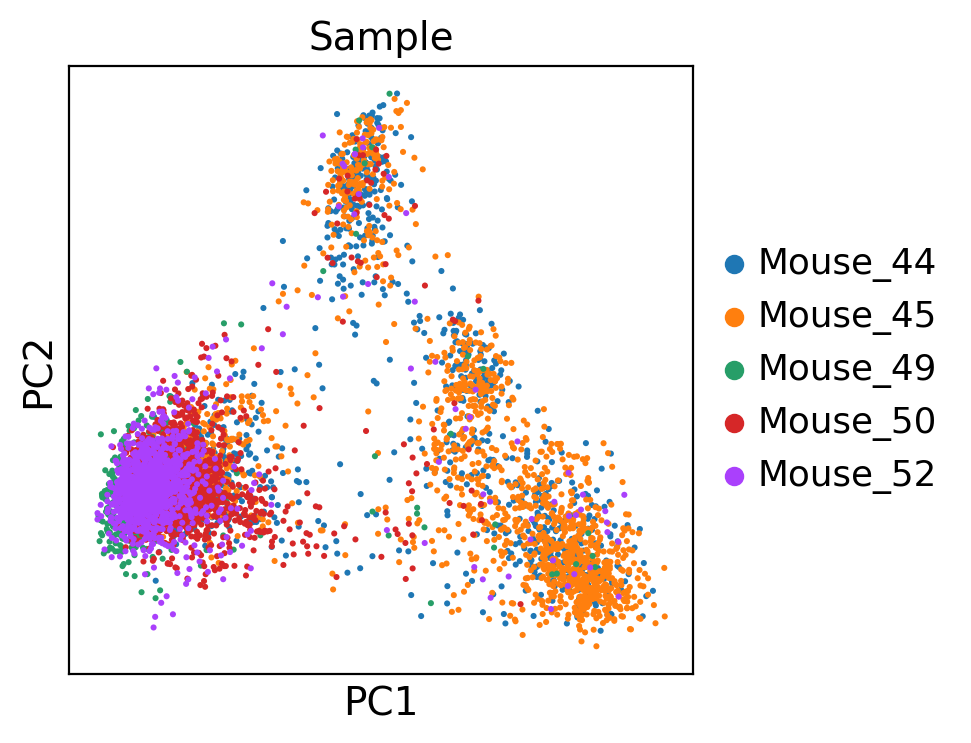

In [33]:
# Aplicar PCA usando los datos del layer 'scVI_normalized'
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True, layer='scVI_normalized')

# Representar el PCA coloreado por la columna "Sample" para ver los ratones
sc.pl.pca_scatter(adata, color="Sample")


In [15]:
!sbatch /data/scratch/LAB/enric/TFM_enric/scripts_auxiliares_jupyter/scvi_diff_expression.sh
#Podemos hacer expresion diferencial de los clusteres que queramos

Submitted batch job 717890


In [6]:
import pickle
# Ruta al archivo .pkl
pkl_file = "/data/scratch/LAB/enric/TFM_enric/03_Analisis_scRNAseq_python/Analisis_expresion_differencial/markers_scvi2.pkl"

# Cargar los datos desde el archivo .pkl
with open(pkl_file, 'rb') as f:
    markers_scvi = pickle.load(f)

# Convertir los datos a un DataFrame de pandas
df_markers = pd.DataFrame(markers_scvi)
df_markers

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Lrrc23,0.9832,0.0168,4.069433,0.000007,0.000005,0.0,0.25,5.284760,5.838699,5.910720,...,0.006316,0.003371,0.004731,0.003328,0.079042,0.041321,True,0 vs Rest,0,Rest
Rarg,0.9812,0.0188,3.954919,0.000003,0.000030,0.0,0.25,-2.425207,-3.331425,5.909687,...,0.001171,0.046908,0.000860,0.051715,0.013694,0.542344,True,0 vs Rest,0,Rest
Gm11690,0.9810,0.0190,3.944133,0.000214,0.000068,0.0,0.25,5.748396,5.590080,5.020244,...,0.058516,0.018076,0.041720,0.016385,0.761676,0.228111,True,0 vs Rest,0,Rest
Ttbk1,0.9778,0.0222,3.785212,0.000006,0.000001,0.0,0.25,4.705182,4.705752,4.195380,...,0.020559,0.004434,0.015054,0.004608,0.267536,0.054900,True,0 vs Rest,0,Rest
Tex45,0.9776,0.0224,3.776039,0.000030,0.000003,0.0,0.25,5.558578,5.723033,4.054467,...,0.017497,0.003133,0.012473,0.003072,0.228215,0.038297,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Ftl1,0.5298,0.4702,0.119341,0.002407,0.002492,0.0,0.25,-0.059495,-0.017580,0.518843,...,2.842255,2.765545,0.972222,0.967040,35.252704,34.430690,False,8 vs Rest,8,Rest
Actb,0.4764,0.5236,-0.094470,0.004653,0.004644,0.0,0.25,-0.008074,-0.012310,0.452725,...,4.909554,4.336651,0.986111,0.998052,60.395078,54.707047,False,8 vs Rest,8,Rest
Cd74,0.4716,0.5284,-0.113722,0.007132,0.006043,0.0,0.25,0.325225,0.163442,0.670000,...,5.743948,5.115550,1.000000,0.958597,70.313606,64.675554,False,8 vs Rest,8,Rest
Cmss1,0.4660,0.5340,-0.136210,0.003294,0.003467,0.0,0.25,-0.077272,-0.080524,0.361491,...,3.553532,3.632271,1.000000,0.992369,43.495803,45.768501,False,8 vs Rest,8,Rest


In [7]:
df_markers = df_markers[(df_markers['is_de_fdr_0.05']) & (df_markers.lfc_mean > .5)]
df_markers

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
Lrrc23,0.9832,0.0168,4.069433,0.000007,0.000005,0.0,0.25,5.284760,5.838699,5.910720,...,0.006316,0.003371,0.004731,0.003328,0.079042,0.041321,True,0 vs Rest,0,Rest
Gm11690,0.9810,0.0190,3.944133,0.000214,0.000068,0.0,0.25,5.748396,5.590080,5.020244,...,0.058516,0.018076,0.041720,0.016385,0.761676,0.228111,True,0 vs Rest,0,Rest
Ttbk1,0.9778,0.0222,3.785212,0.000006,0.000001,0.0,0.25,4.705182,4.705752,4.195380,...,0.020559,0.004434,0.015054,0.004608,0.267536,0.054900,True,0 vs Rest,0,Rest
Tex45,0.9776,0.0224,3.776039,0.000030,0.000003,0.0,0.25,5.558578,5.723033,4.054467,...,0.017497,0.003133,0.012473,0.003072,0.228215,0.038297,True,0 vs Rest,0,Rest
Scn4a,0.9748,0.0252,3.655388,0.000018,0.000004,0.0,0.25,4.581786,4.344785,4.924995,...,0.045054,0.021366,0.032258,0.020225,0.585489,0.271916,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pim1,0.9040,0.0960,2.242481,0.001560,0.000858,0.0,0.25,0.992930,1.024738,0.752611,...,1.581875,0.706571,0.986111,0.457055,18.975731,8.515386,True,8 vs Rest,8,Rest
Dusp5,0.9040,0.0960,2.242481,0.000293,0.000236,0.0,0.25,0.927967,0.979871,1.620206,...,0.397612,0.295176,0.375000,0.214970,4.653362,3.593798,True,8 vs Rest,8,Rest
Zhx3,0.9032,0.0968,2.233297,0.000073,0.000068,0.0,0.25,0.612171,0.711166,2.129453,...,0.027883,0.016505,0.041667,0.015587,0.290160,0.202781,True,8 vs Rest,8,Rest
Ahnak,0.9032,0.0968,2.233297,0.000500,0.000444,0.0,0.25,1.093158,0.901609,1.978059,...,0.470987,0.405281,0.430556,0.263030,5.632396,4.964062,True,8 vs Rest,8,Rest


In [9]:
marker_genes_mouse = {
    "CD14+ Mono": ["Fcn1", "Cd14"],
    "CD16+ Mono": ["Tcf7l2", "Fcgr3a", "Lyn"],
    "ID2-hi myeloid prog": [
        "Cd14",
        "Id2",
        "Vcan",
        "S100a9",
        "Clec12a",
        "Klf4",
        "Plaur",
    ],
    "cDC1": ["Clec9a", "Cadm1"],
    "cDC2": [
        "Cst3",
        "Cotl1",
        "Lyz",
        "Dmxl2",
        "Clec10a",
        "Fcer1a",
    ],
    "Normoblast": ["Slc4a1", "Slc25a37", "Hbb", "Hba2", "Hba1", "Tfrc"],
    "Erythroblast": ["Mki67", "Hba1", "Hbb"],
    "Proerythroblast": [
        "Cdk6",
        "Syngr1",
        "Hbm",
        "Gypa",
    ],
    "NK": ["Gnly", "Nkg7", "Cd247", "Grik4", "Fcer1g", "Tyrobp", "Klrg1", "Fcgr3a"],
    "ILC": ["Id2", "Plcg2", "Gnly", "Syne1"],
    "Lymph prog": [
        "Vpreb1",
        "Mme",
        "Ebf1",
        "Ssbp2",
        "Bach2",
        "Cd79b",
        "Ighm",
        "Pax5",
        "Prkce",
        "Dntt",
        "Igll1",
    ],
    "Naive CD20+ B": ["Ms4a1", "Il4r", "Ighd", "Fcrl1", "Ighm"],
    "B1 B": [
        "Ms4a1",
        "Sspn",
        "Itgb1",
        "Epha4",
        "Col4a4",
        "Prdm1",
        "Irf4",
        "Cd38",
        "Xbp1",
        "Pax5",
        "Bcl11a",
        "Blk",
        "Ighd",
        "Ighm",
        "Zfp215",
    ],
    "Transitional B": ["Mme", "Cd38", "Cd24", "Acsm3", "Msi2"],
    "Plasma cells": ["Mzb1", "Hsp90b1", "Fndc3b", "Prdm1", "Igkc", "Jchain"],
    "Plasmablast": ["Xbp1", "Irf4", "Prdm1", "Pax5"],
    "CD4+ T activated": ["Cd4", "Il7r", "Trbc2", "Itgb1"],
    "CD4+ T naive": ["Cd4", "Il7r", "Trbc2", "Ccr7"],
    "CD8+ T": ["Cd8a", "Cd8b", "Gzmk", "Gzma", "Ccl5", "Gzmb", "Gzmh", "Gzma"],
    "T activation": ["Cd69", "Cd38"],
    "T naive": ["Lef1", "Ccr7", "Tcf7"],
    "pDC": ["Gzmb", "Il3ra", "Cobll1", "Tcf4"],
    "G/M prog": ["Mpo", "Bcl2", "Kcnq5", "Csf3r"],
    "HSC": ["Nrip1", "Mecom", "Prom1", "Nkain2", "Cd34"],
    "MK/E prog": ["Zfp385d", "Itga2b", "Ryr3", "Plcb1"],
}

In [11]:
marker_genes_in_data = dict()
for ct, markers in marker_genes_mouse.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

/home/evercher/tmpdir/ipykernel_8352/3946896226.py:10: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.5)


NAIVE CD20+ B:


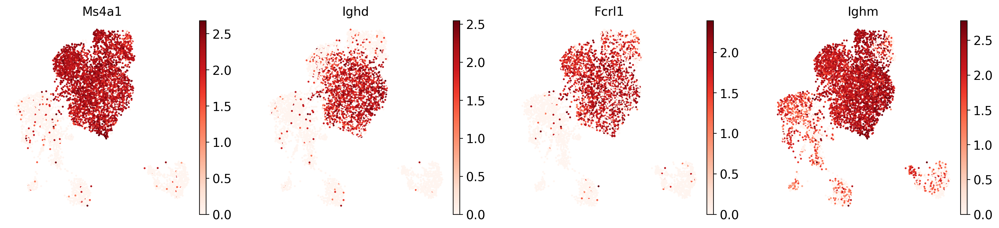





B1 B:


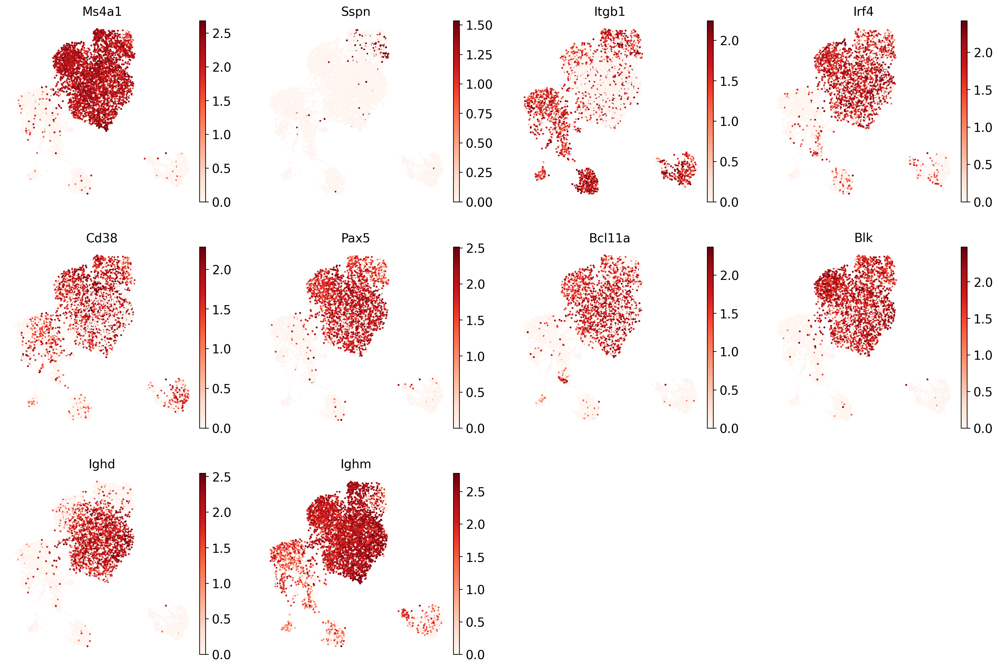





TRANSITIONAL B:


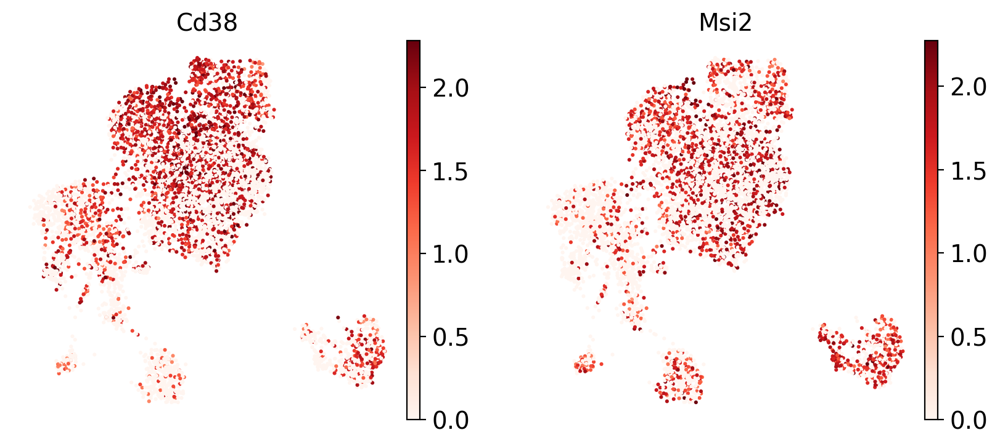





PLASMA CELLS:


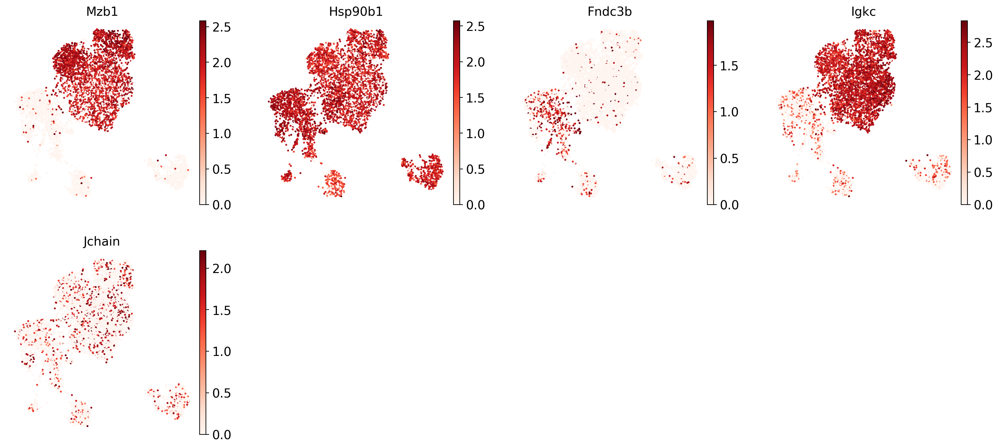





PLASMABLAST:


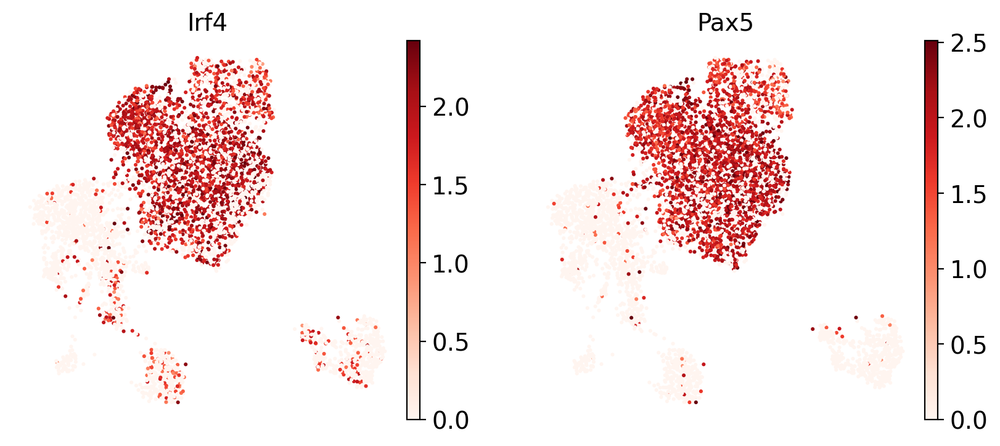

In [16]:
# Asegurarte de que las representaciones latentes de scVI están en adata.obsm
if 'X_scVI' in adata.obsm:
    # Usar las representaciones latentes en 'X_scVI' para construir el gráfico de vecinos
    sc.pp.neighbors(adata, use_rep='X_scVI')

    # Calcular el UMAP utilizando las representaciones latentes
    sc.tl.umap(adata)

    # Realizar clustering con Leiden
    sc.tl.leiden(adata, resolution=0.5)

    # Definir los subtipos de células B/plasma
    B_plasma_cts = [
        "Naive CD20+ B",
        "B1 B",
        "Transitional B",
        "Plasma cells",
        "Plasmablast",
    ]

    # Visualizar la expresión de los genes marcadores en el UMAP para cada subtipo de célula
    for ct in B_plasma_cts:
        print(f"{ct.upper()}:")  # Imprimir el nombre del subtipo de célula
        sc.pl.umap(
            adata,
            color=marker_genes_in_data[ct],  # Mostrar los genes marcadores para este subtipo
            vmin=0,
            vmax="p99",  # Limitar el valor máximo al percentil 99 para evitar que los valores atípicos oculten la expresión en otras células
            sort_order=False,  # No ordenar por la expresión más alta
            frameon=False,
            cmap="Reds",  # Elegir el mapa de colores
        )
        print("\n\n\n")  # Espacios en blanco para mejorar la legibilidad
else:
    print("Las representaciones latentes 'X_scVI' no están presentes en el objeto AnnData.")


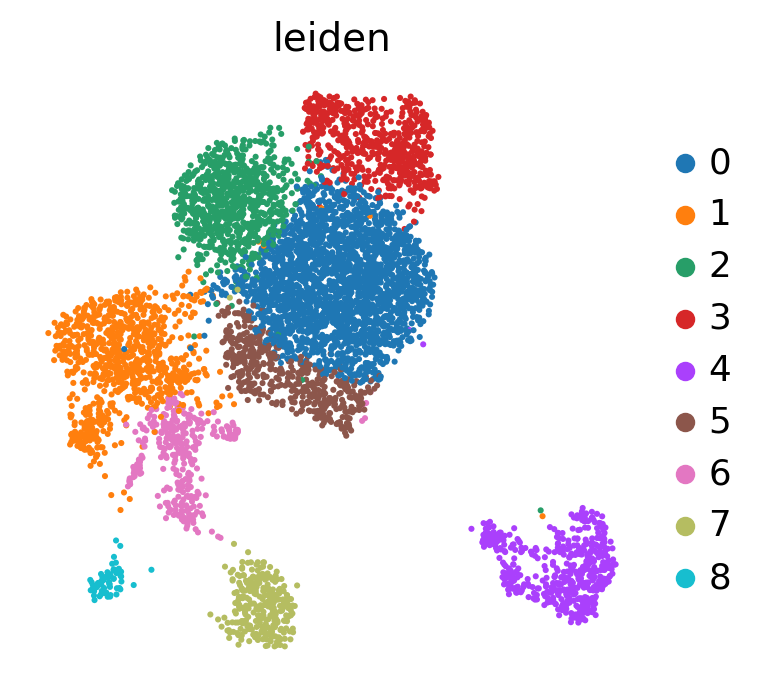

In [34]:
sc.pl.umap(adata, color = ['leiden'], frameon = False)

In [21]:
cell_type= {"0":"B-cells.A",
"1":"Macrophages-A",
"2":"B-cells.B",
"3":"B-cells.C",
"4":"TL-NK",
"5":"B-cells.D",
"6":"cDC1",
"7":"cDC1",
"8":"Macrophages-DC",}

In [22]:
adata.obs['cell_type']= adata.obs.leiden.map(cell_type)

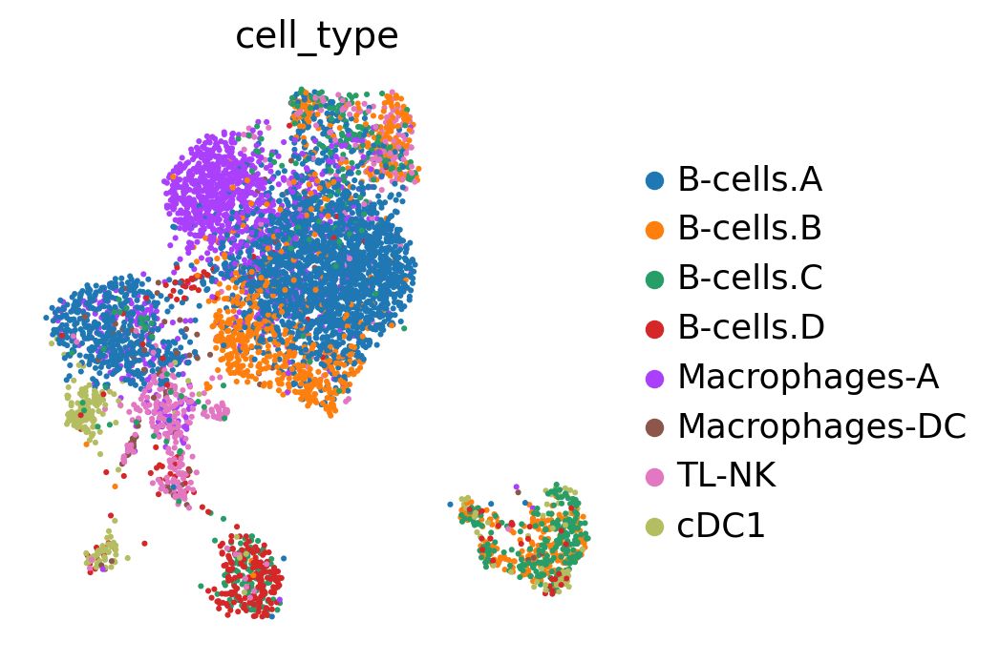

In [23]:
sc.pl.umap(adata, color = ['cell_type'], frameon = False)

In [46]:
markers = {}
for c in adata.obs.leiden.cat.categories:
    cell_df = df_markers.loc[df_markers.group1 == c]
    markers[c] = cell_df.index.tolist()[:6]

In [47]:
markers

{'0': ['Lrrc23', 'Gm11690', 'Ttbk1', 'Tex45', 'Scn4a', 'Gm15675'],
 '1': ['Cxcl14', 'Ptgs1', 'Prune2', 'Fcgr4', 'Lilra5', 'Trem2'],
 '2': ['S1pr3', 'Pik3r4', 'Dtx1', 'Ptpn14', 'Cyp39a1', 'Ackr3'],
 '3': ['Sspn', 'Zbtb32', 'Sh2d6', 'Gm9922', 'Ahnak2', 'AC125149.3'],
 '4': ['Cd3g', 'Trbc1', 'Thy1', 'Ubash3a', 'Nkg7', 'Cd28'],
 '5': ['Wnt10a', 'Cdkl1', 'Nrgn', 'Rgs13', 'Klrc1', 'Gm2447'],
 '6': ['Mcemp1', 'Gpr141', 'Ccr2', 'Krt80', 'Mgl2', 'Eepd1'],
 '7': ['Adcy6', 'Strip2', 'Stap2', 'Nudt17', 'Ramp3', 'Ccl22'],
 '8': ['Clec9a', 'Itgae', 'Naaa', 'Olfm1', 'Qpct', 'Snx22']}

In [ ]:
for item in df_markers[df_markers.group1=='0'][0:1000].index:
    print(item)

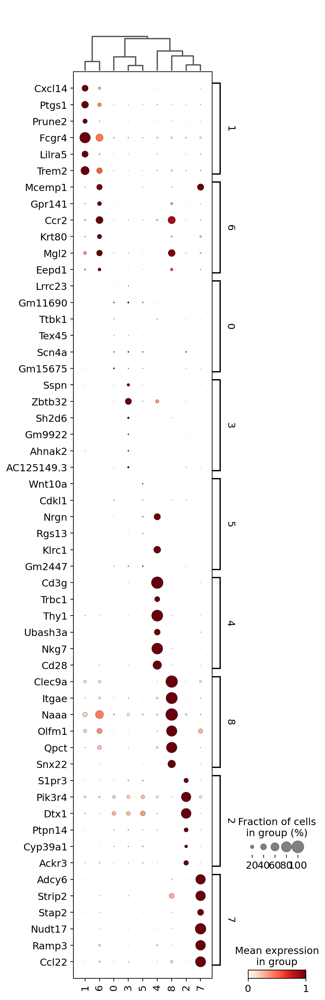

In [49]:
# Calcular el dendrograma basado en la agrupación 'leiden'
sc.tl.dendrogram(adata, groupby='leiden')

# Crear el dotplot con el dendrograma calculado
sc.pl.dotplot(adata, markers, groupby='leiden', swap_axes=True,
              use_raw=False, standard_scale='var', dendrogram=True)

In [51]:
print(adata.obs['Sample'].value_counts())


Sample
Mouse_50    1773
Mouse_45    1667
Mouse_52    1190
Mouse_44    1087
Mouse_49     514
Name: count, dtype: int64


In [52]:
model.differential_expression(groupby = "Sample", group1 = 'Mouse_44', group2 = 'Mouse_45')

NameError: name 'model' is not defined

In [56]:
#any set of cells vs any set of cells
model.differential_expression(idx1 = [(adata.obs.Sample == 'Mouse_44') & (adata.obs.leiden == '1')],
                             idx2 = [(adata.obs.Sample == 'Mouse_45') & (adata.obs.leiden == '1')])

DE...: 100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,lfc_min,lfc_max,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05
Ighv1-2,0.9624,0.0376,3.242426,1.577657e-06,0.000001,0.0,0.25,1.098805,0.919059,4.790550,-18.060379,17.988777,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,True
Adamts14,0.9588,0.0412,3.147244,3.323666e-07,0.000002,0.0,0.25,-1.929937,-1.715777,4.536479,-16.961647,13.508410,0.000000,0.001325,0.000000,0.001325,0.000000,0.002694,True
Igkv1-88,0.9550,0.0450,3.055049,1.518801e-05,0.000004,0.0,0.25,2.383254,2.310346,3.701624,-12.452479,15.354935,0.000978,0.000000,0.000978,0.000000,0.010682,0.000000,True
Olfr920,0.9522,0.0478,2.991749,4.247946e-07,0.000002,0.0,0.25,-1.631977,-1.576370,3.666656,-14.060009,11.109354,0.000000,0.003974,0.000000,0.003974,0.000000,0.009378,True
Smpd3,0.9490,0.0510,2.923583,2.023371e-05,0.000015,0.0,0.25,1.451903,1.191423,3.826220,-12.527209,13.641113,0.000000,0.001325,0.000000,0.001325,0.000000,0.008356,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Phb,0.6112,0.3888,0.452359,1.993214e-04,0.000193,0.0,0.25,0.066003,0.040511,0.503111,-1.579056,2.079056,0.142857,0.242384,0.118395,0.192053,2.054229,1.398877,False
Rsu1,0.6018,0.3982,0.412971,2.054630e-04,0.000211,0.0,0.25,-0.024381,-0.027499,0.499803,-1.910151,1.883435,0.145792,0.292715,0.124266,0.227815,1.846930,2.041813,False
Dnajc7,0.5912,0.4088,0.368928,2.506303e-04,0.000238,0.0,0.25,0.067753,0.063553,0.493556,-2.845456,2.780362,0.175146,0.327153,0.125245,0.237086,1.878718,2.188097,False
Atp1a1,0.5862,0.4138,0.348278,2.439696e-04,0.000243,0.0,0.25,0.021168,0.037899,0.502866,-1.939404,2.480694,0.168297,0.462252,0.142857,0.279470,2.101559,2.521767,False
